<a href="https://colab.research.google.com/github/deibyrios/bacteria-classification/blob/zhejindong/heatmap_obj_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import matplotlib.image as mpimg
import math
import copy
import time
import cv2 as cv
import glob
import random
import torch
import torchvision
import numpy as np 
from torchvision import transforms, datasets
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import cv2
from torch import nn
from torch import optim
import torch.nn.functional as F
import torchvision
from torchvision import datasets, transforms, models
from skimage import io
import re
import warnings
import os
from torch.utils.data.sampler import SubsetRandomSampler
warnings.filterwarnings('ignore')

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import zipfile
import shutil
from google.colab import files
import json
import time
import pandas as pd

import keras
from keras.models import Model, Sequential, load_model
from keras.applications.resnet50 import ResNet50
from keras.layers import Input, Dense, Activation, Dropout, BatchNormalization,\
                          Conv2D, MaxPooling2D, Flatten, AveragePooling2D,\
                          GlobalAveragePooling2D, ZeroPadding2D
from keras.initializers import glorot_uniform
from keras import regularizers
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import RMSprop, Adam, Adamax, Nadam, SGD
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

from sklearn.metrics import roc_auc_score, accuracy_score, confusion_matrix, \
                            classification_report

# # for auto reloading the Utils functions
# %load_ext autoreload
# %autoreload 2
# %matplotlib inline

Using TensorFlow backend.


In [0]:
from shutil import rmtree
rmtree('./Outputs')
#rmtree('./Outputs')
#rmtree('/content/mixed_colony_images_nogt')

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
# import torch.nn as nn
# import torch.nn.functional as F
# class Net(nn.Module):
#     def __init__(self):
#         super(Net, self).__init__()
#         self.conv1 = nn.Conv2d(3, 32, 5)
#         self.fc1 = nn.Linear(115200, 120)
#         self.fc3 = nn.Linear(120, 8)
        
#     def forward(self, x):
#         x = F.relu(self.conv1(x)) 
#         x = x.view(x.shape[0],-1)
#         x = F.relu(self.fc1(x))
#         x = self.fc3(x)
#         return x

# net = Net()
# PATH = './drive/My Drive/Capstone/shallow_net_bacteria64_serial.pth'
# net.load_state_dict(torch.load(PATH))

<All keys matched successfully>

## Load the well trained model 

Replace this with most updated classifier 

In [0]:
# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

file_id = '1w0u_EKaSG8zkMRtYkNjFd3IOnR3IpQsJ' # model_8_classes_0.8465

downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile(downloaded['title'])
print('Downloaded content: "{}"'.format(downloaded['title']))
print('Root dir content: {}'.format(os.listdir()))
model_8_classes = downloaded['title']

Downloaded content: "model_8_classes_08465.h5"
Root dir content: ['.config', 'adc.json', 'model_8_classes_08465.h5', 'drive', 'sample_data']


In [0]:
# this model is for 128*128*3 input shape is (64,128,128,3) and the patch keeps the background 
eight_classes_model = load_model(model_8_classes)

## Object detection on mixed colony data

In [0]:
!unzip './drive/My Drive/Capstone/mixed_colony_images.zip' 

In [0]:
!mkdir 'mixed_colony_images'

In [0]:
!mv './mixed_colony_images_gt' 'mixed_colony_images/'

## Image preprocessing 

In [0]:
def get_files(folder):
    """
    Returns a list of file_paths for each file in the specified folder. 
    :param folder: The folder where files are located.
    :return: A list of file_paths for each file in the specified folder.
    """
    files = os.listdir(folder)
    paths = []
    for x in files:
        paths.append(os.path.join(folder, x))
    return paths

def circles_mask(img_shape, circles, p=0):
    """
    Given an image_size (width, height) and an array of n circles in the form
    [[x1, y1, r1], [x2, y2, r2], ... [xn, yn, rn]], return a mask with all pixels outside each and
    every circle painted white (255) and the complement, painted black (0).
    :param img_shape: Tuple. (mask_width, mask_height). Size of the resulting mask e.g. (64 ,64).
    :param circles: Nested array of circles: [[x1, y1, r1], [x2, y2, r2], ... [xn, yn, rn]]
                    x,y represent the cricle's center in pixels and r the circle's radius.
    :param p: Int. Each circle radius will be reduced p pixels so resulting mask will be smaller.
    :return: A mask a mask with all pixels outside each and every circle painted white (255)
             and the complement, painted black (0).
    """
    mask = np.zeros(img_shape, dtype="uint8") # Black image as initial mask. We will paint white outside the circles 
    for x, y, r in circles: # For each circle from the given circles
        white = np.ones(img.shape, dtype="uint8")*255 # Create a 'white' image
        cv.circle(white, (x,y), int(r-p), 0, -1)  # 0: to paint black, -1: to draw black filled circles
        white[mask==255] = 0 # We won't add white pixels where there are already white pixels in the mask 
        mask = mask + white # Mask was black. Now pixels outside of circle will be white
    return mask
def crop_img(img, mask, circles, p=0):
    """
    Given an image, a corresponding image's mask and an array of n circles in the form
    [[x1, y1, r1], [x2, y2, r2], ... [xn, yn, rn]], return the image and the mask, 
    cropped as much as possible to only contain the given circles.
    :param img: Array. Array of the form (width, height, channels): the image to be cropped.
    :param mask: Array. Array of the form (width, height): the mask to be cropped.
    :param circles: Nested array of circles: [[x1, y1, r1], [x2, y2, r2], ... [xn, yn, rn]]
                    x,y represent the cricle's center in pixels and r the circle's radius.
    :param p: Int. Parameter to extend the crop area beyond the given circles.
    :return: Tuple. (cropped_img, corpped_mask).
    """
    mean_circle = np.mean(circles, axis=0)
    max_r = int(np.amax(circles, axis=0)[2])
    left, top = int(mean_circle[0] - max_r), int(mean_circle[1] - max_r) 
    crop_img = img[top-p:top+2*max_r+p, left-p:left+2*max_r+p]
    crop_mask = mask[top-p:top+2*max_r+p, left-p:left+2*max_r+p]
    return crop_img, crop_mask


In [0]:
folder = './mixed_colony_images/mixed_colony_images_gt'
files = get_files(folder) # Returns array of all file_paths in the specified folder.

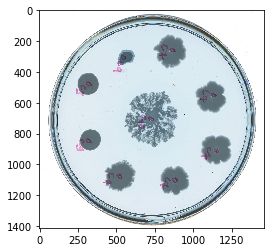

In [0]:
#files
plt.imshow(cv.imread(files[2]))
img=cv.imread(files[2],cv.IMREAD_COLOR)
plt.imshow(img)

In [0]:
img = cv.imread(files[12],cv.IMREAD_GRAYSCALE)
circles=cv.HoughCircles(img, cv.HOUGH_GRADIENT, dp=1.5, minDist=1e-12,
                               param1=535, param2=500, minRadius=620, maxRadius=850) 

(1413, 1461, 3)


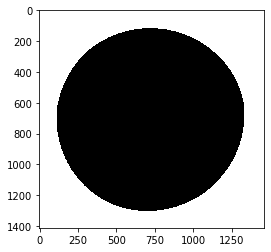

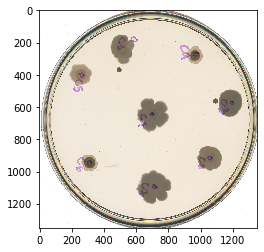

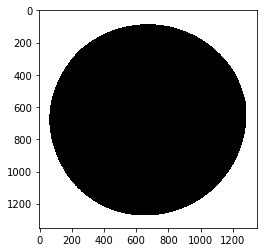

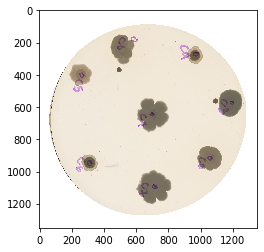

In [0]:
p=0
mask = circles_mask(img.shape, circles[0], p=0)
print(mask.shape)
plt.imshow(mask)
#p = 0 # parameter to extend cropped images beyond the circles to ensure we get the entire dish
color_img = io.imread(files[0])
color_img, mask = crop_img(color_img, mask, circles[0])
plt.figure()
plt.imshow(color_img)
plt.figure()
plt.imshow(mask)
color_img[mask!=0] = 255
plt.figure()
plt.imshow(color_img)

In [0]:
if "Processed_images" not in os.listdir('./'):
    os.mkdir('./Processed_images')
if 'no_dish_border_gt' not in os.listdir('./Processed_images'):
    os.mkdir('./Processed_images/no_dish_border_gt')
if 'Masks' not in os.listdir('./'):
    os.mkdir('./Masks')
if 'Circles' not in os.listdir('./Masks'):
    os.mkdir('./Masks/Circles')

In [0]:
folder = './mixed_colony_images/mixed_colony_images_gt'
files = get_files(folder) # Returns array of all file_paths in the specified folder.
for im in files:
    print(im)
    img = cv.imread(im,cv.IMREAD_GRAYSCALE)
    """Identify circles and create circles mask:"""
    circles = cv.HoughCircles(img, cv.HOUGH_GRADIENT, dp=1.5, minDist=1e-12,
                               param1=535, param2=500, minRadius=620, maxRadius=750) 
    p = 0 # parameter to cut images. Adjusted for each location to ensure we completely remove borders
    mask = circles_mask(img.shape, circles[0], p) # Create circles mask
    """Crop original image and mask (to reduce white background) and save"""
    p = 0 # parameter to extend cropped images beyond the circles to ensure we get the entire dish
    color_img = io.imread(im)
    color_img, mask = crop_img(color_img, mask, circles[0],p=0)
    inverse_mask = cv.bitwise_not(mask) # from white ouside to white inside circle
    save_path = './Masks/Circles/' + im[-12:]   
    io.imsave(save_path, inverse_mask)
    """In cropped image, remove pixels outside circles mask and save no border image"""
    mask = mask.astype(int)
    color_img[mask!=0] = 255 # set all pixels outside the mask, to white color
    save_path = './Processed_images/no_dish_border_gt/' + im[-12:] 
    io.imsave(save_path, color_img)
    """show results"""
    plt.figure(figsize=(6,8))
    plt.imshow(color_img) 
    plt.show()

In [0]:
# folder = './Processed_images/no_dish_border_gt'
# files = get_files(folder) # Returns array of all file_paths in the specified folder.
# img=io.imread(files[12])
# plt.imshow(img)

# folder = './Masks/'
# files = get_files(folder) # Returns array of all file_paths in the specified folder.
# img=io.imread(files[12])
# plt.figure()
# plt.imshow(img)

Found 30 images belonging to 1 classes.


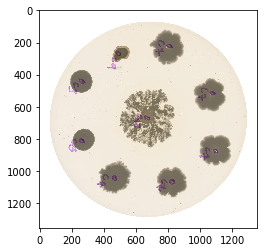

In [0]:
c1_pos_folder = './Processed_images/no_dish_border_gt'
img = plt.imread(c1_pos_folder + '/' + os.listdir(c1_pos_folder)[:5][0])
plt.imshow(img)
img_size = img.shape
val_batch_size = 1
val_datagen = ImageDataGenerator(rescale=1./255)
val_generator = val_datagen.flow_from_directory(
        './Processed_images',
        target_size=(img_size[0],img_size[1]),
        batch_size=val_batch_size,
        class_mode='categorical',
        shuffle=False)

In [0]:
if "Outputs" not in os.listdir('./'):
    os.mkdir('./Outputs')

In [0]:
def pos_detect(patch,window):
  """the patch has shape eg (128,128,3)"""
  min_pos=(window*window*3/3)
  if (patch<0.7).sum()>=min_pos:
    return True 
  else:
    return False

def get_hot_bboxes(img,net,confidence_thresh,target): 
    # classifier was trained on 128x128 images
    window = 128
    H, W   = img[0].shape[0:2]
    # get current image region of interest params
    y_start = 0
    x_start = 0
    hot_bboxes = []
    num_boxes  = 0 
    # loop over all possible windows (with the current scale) in the image
    step=window//4
    for x_start in range(0,W-window,step):
        for y_start in range(0,H-window,step):
            num_boxes += 1
            # extract the image patch pixels
            img_patch = img[:,y_start:y_start+window,x_start:x_start+window,:]
            if img_patch.shape != (1,128,128,3):
              continue    
            if not pos_detect(img_patch[0],window):
              continue 
            outputs=net.predict(img_patch)
            outputs=eight_classes_model.predict(img_patch)
            test_prediction=np.argmax(outputs)
            test_confidence=np.max(outputs)

            # check whether there is a car included according to our classifier
            if (test_prediction == target) & (test_confidence > confidence_thresh):
                # if so, append the current box to the hot bounding boxes list
                hot_bboxes.append(((x_start, y_start),
                                 (window+x_start,window+y_start)))
  
    print('Number of boxes :{}'.format(num_boxes))
    print('total of obj is :{}'.format(len(hot_bboxes)))
    return hot_bboxes

def add_heat(heatmap, bbox_list):
    for box in bbox_list:
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    return heatmap

def apply_threshold(heatmap, threshold):
    heatmap[heatmap <= threshold] = 0 
    return heatmap
    
def draw_labeled_heatmap(img, labels):
    # loop over all distinctly detected patches
    for car_number in range(1, labels[1]+1):
        # get pixel indices for current car_number
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        img = cv2.rectangle(img, bbox[0], bbox[1], (255,0,255), 6)
    return img

def heatmap_generation(heat_threshold,image,boxes,savepath): 
    """image shape is like (1354, 1354, 3)
      boxes is generated from the function get_hot_bboxes()
      draw the heatmap 
    """
    # intialize heat map
    heat = np.zeros_like(image[:,:,0]).astype(np.uint16)
    # add all positive box detections to the heat map
    heat = add_heat(heat,boxes)
    # threshold the heat map
    heat_thresh = apply_threshold(np.copy(heat), heat_threshold)
    # combine the resulting heat map into continuous patches with identifier, and get number of identifications
    labels = label(heat_thresh)
    num_car_det = labels[1]
    # draw the resulting labels on the original test image
    test_img_ann = draw_labeled_heatmap(np.copy(image), labels)
    # Visualize the heat map approach
    fig, plts = plt.subplots(1, 4, figsize=(32,8))
    plts[0].imshow(heat, cmap='gray'); plts[0].axis('off');
    plts[0].set_title('Initial heat map', fontsize=25)
    plts[1].imshow(heat_thresh, cmap='gray'); plts[1].axis('off');
    plts[1].set_title('Thresholding.{}'.format(heat_threshold), fontsize=25)
    # plts[2].imshow(labels[0], cmap='gray'); plts[2].axis('off');
    # plts[2].set_title('After combining', fontsize=25)
    plts[2].imshow(test_img_ann); plts[2].axis('off');
    plts[2].set_title('class {}'.format(target), fontsize=25)
    
    plts[3].imshow(image); plts[3].axis('off');
    plts[3].set_title('Original Image', fontsize=25)
    
    plt.savefig(savepath)
    plt.show()


Looking for : 0


Number of boxes :1521
total of obj is :2


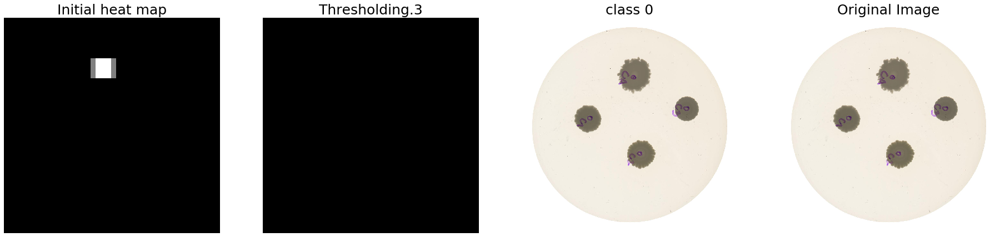

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :9


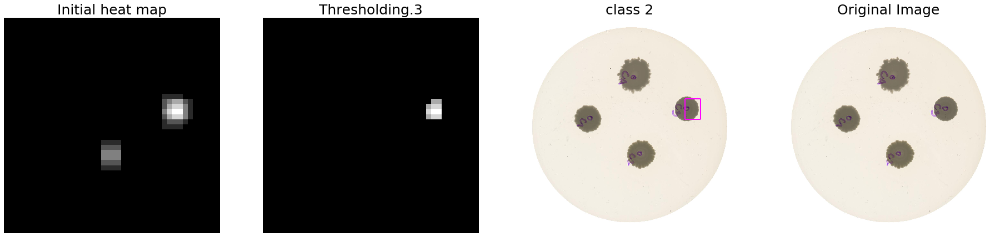

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :34


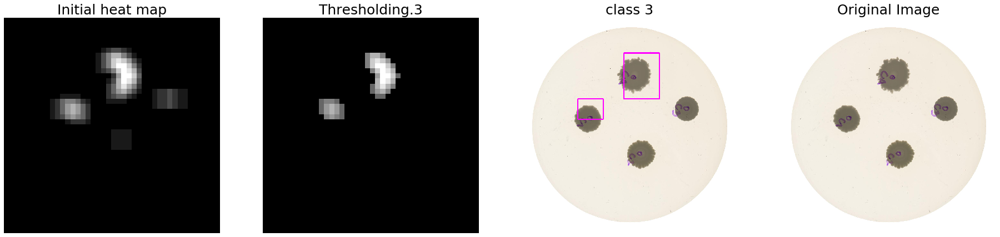

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :15


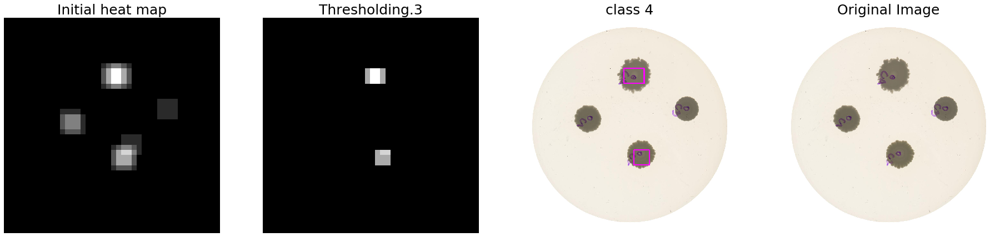

Looking for : 5


Number of boxes :1521
total of obj is :1


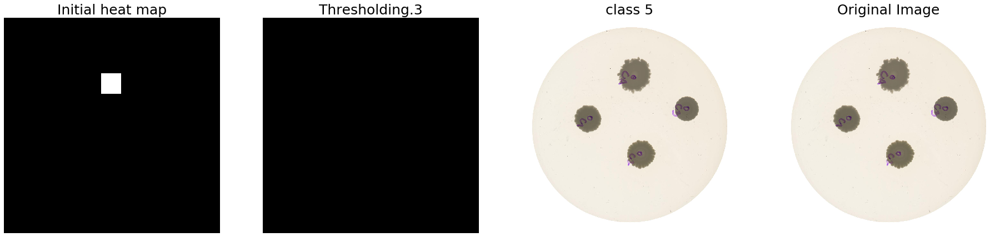

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :91


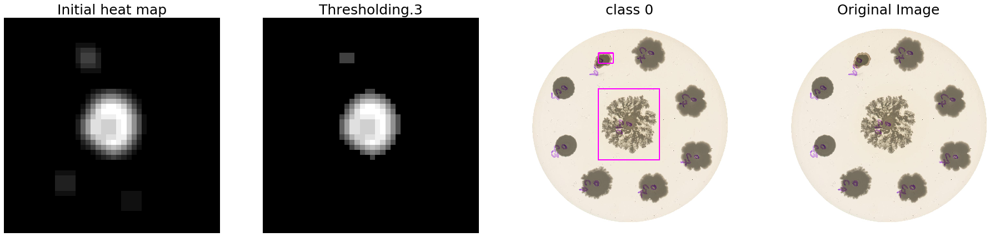

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :10


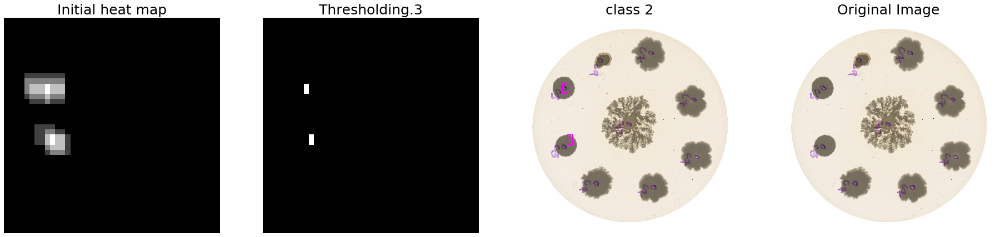

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :110


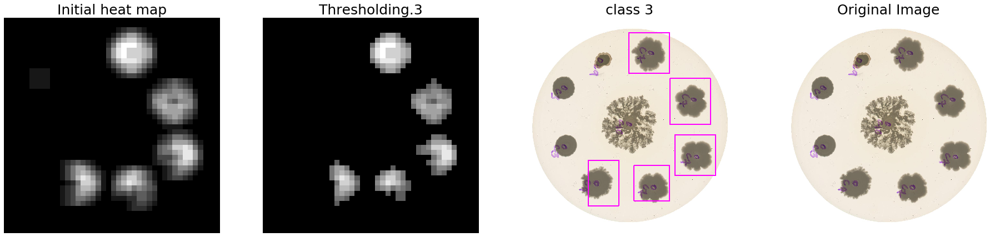

Looking for : 4


Number of boxes :1521
total of obj is :17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


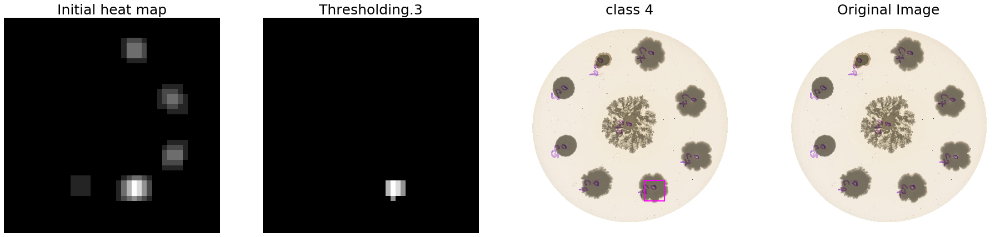

Looking for : 5


Number of boxes :1521
total of obj is :8


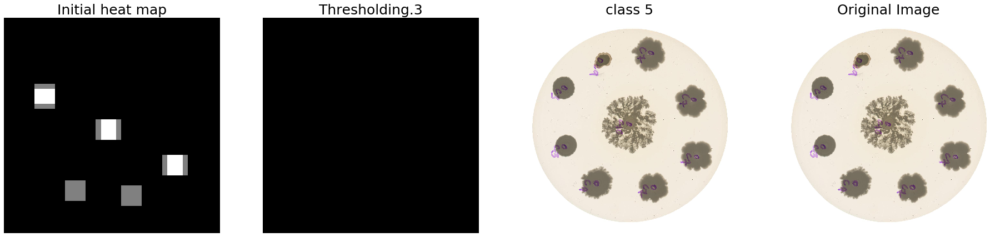

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :2


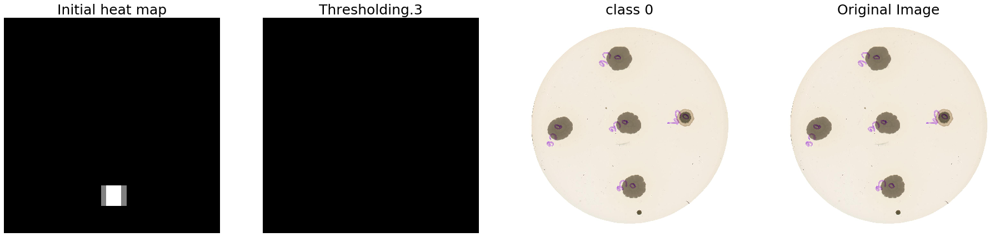

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :35


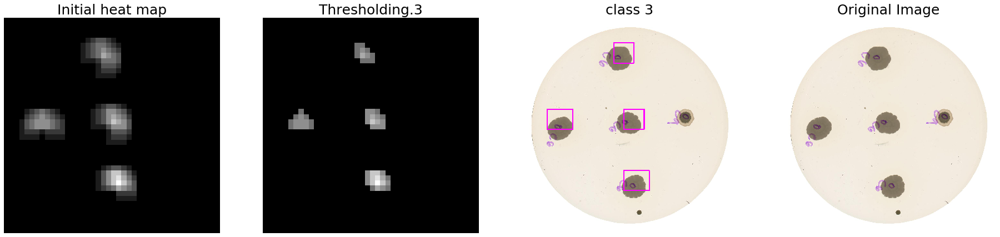

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


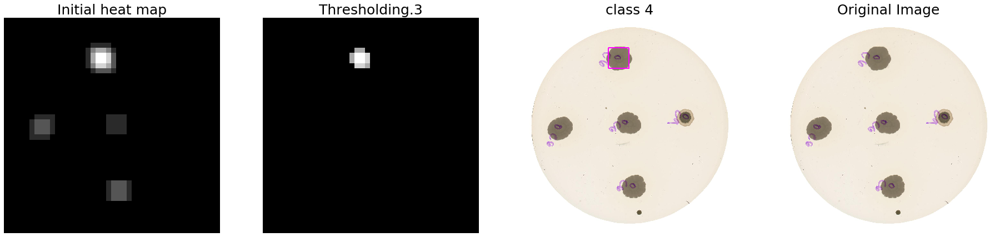

Looking for : 5


Number of boxes :1521
total of obj is :5


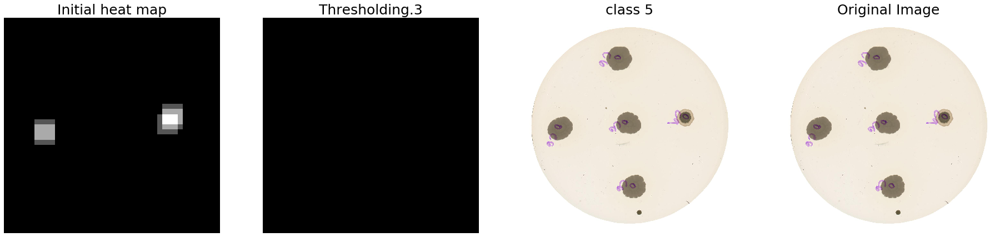

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :4


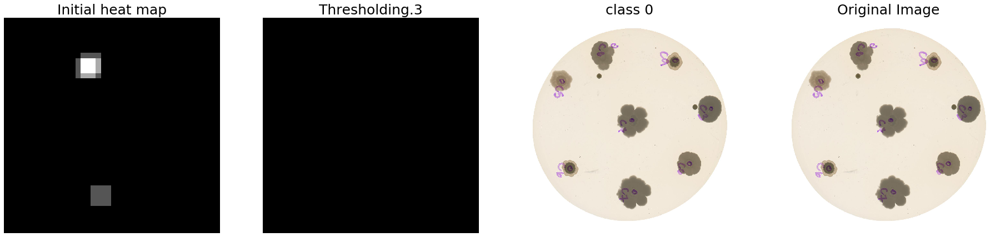

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :3


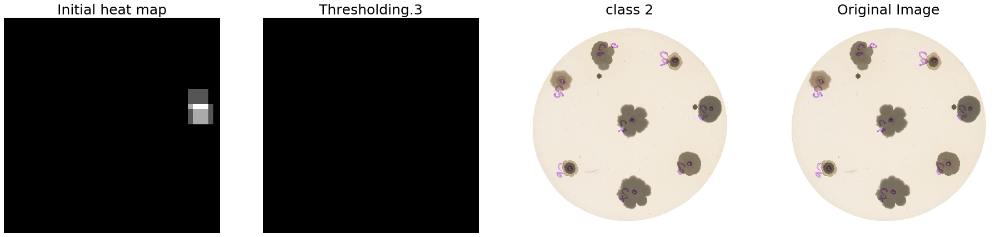

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :56


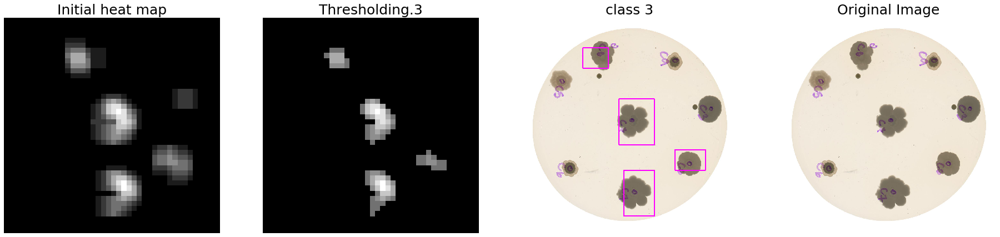

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


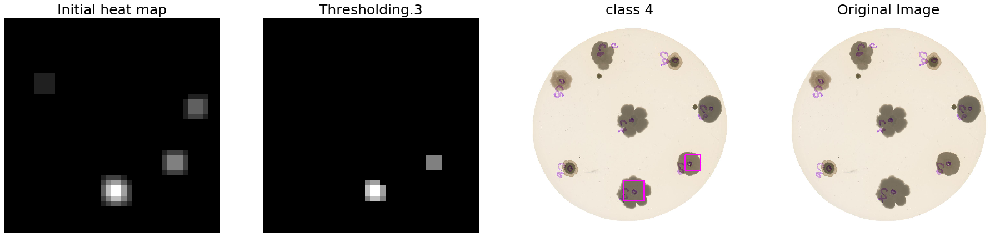

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :6


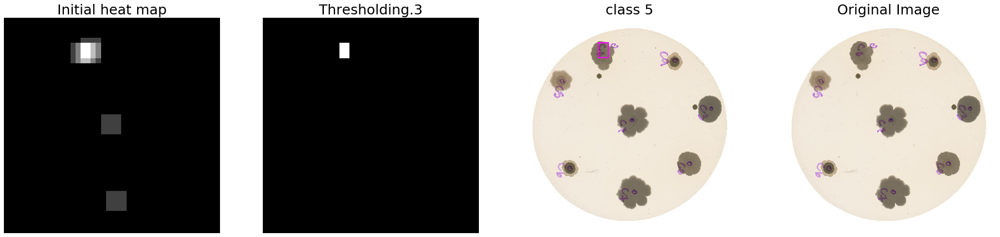

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :260


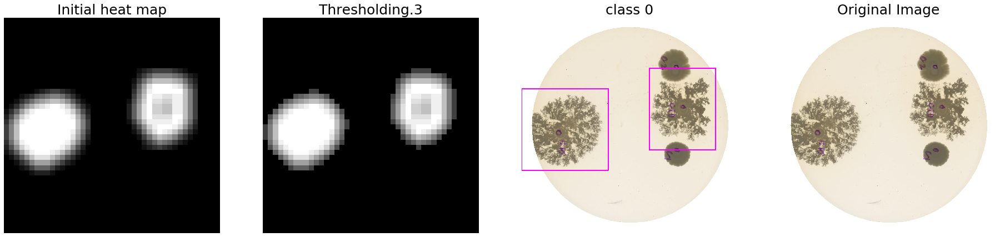

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


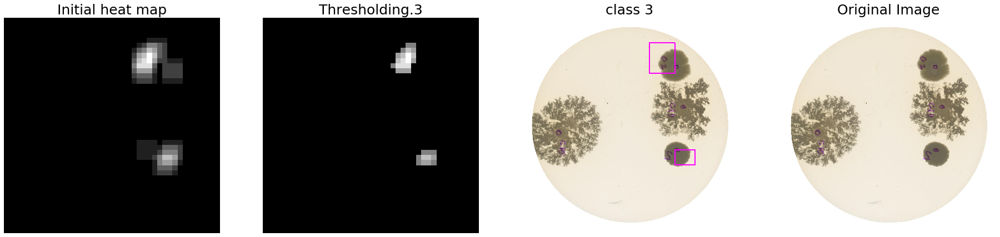

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


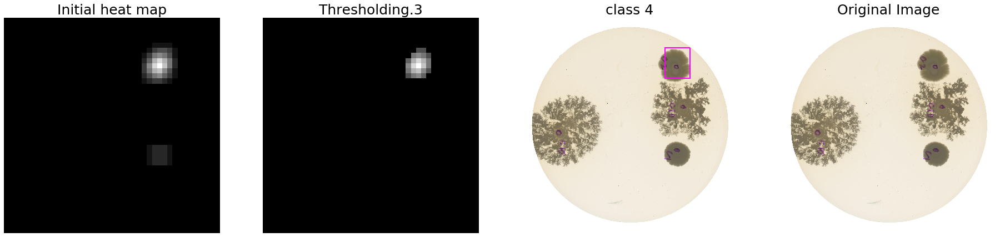

Looking for : 5


Number of boxes :1521
total of obj is :2


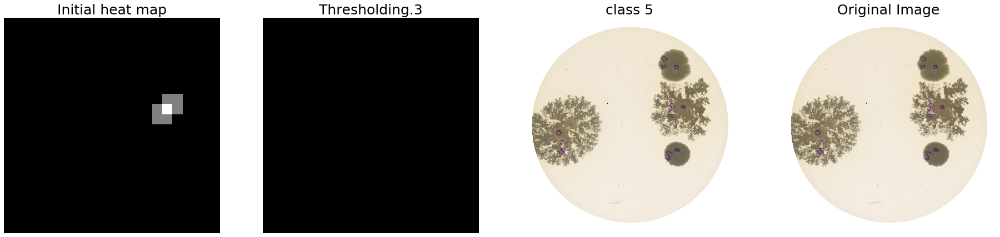

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


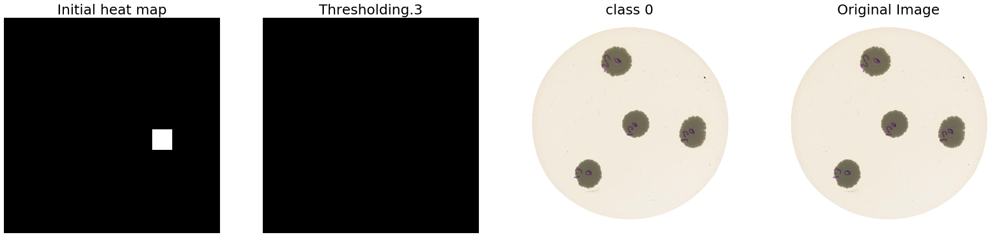

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :47


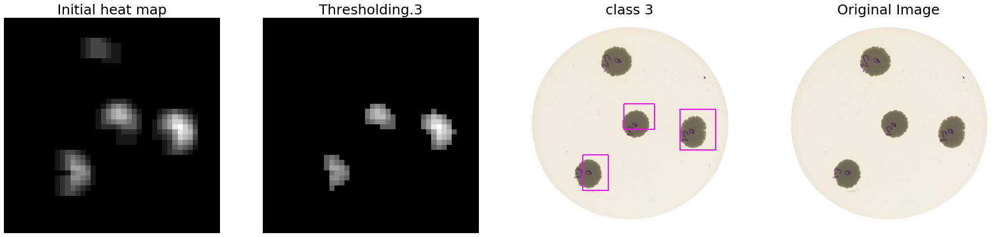

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


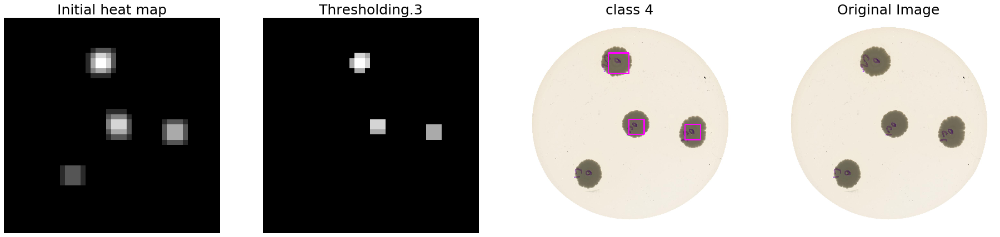

Looking for : 5


Number of boxes :1521
total of obj is :1


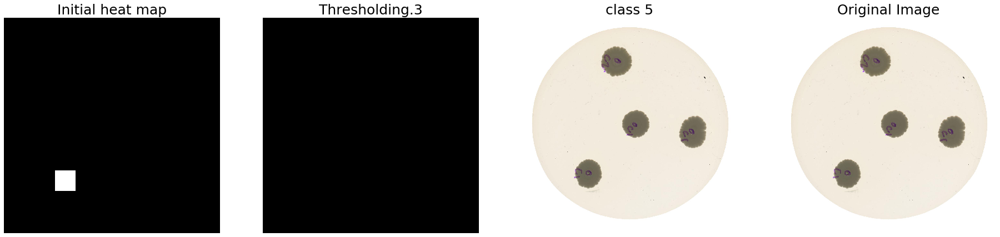

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :248


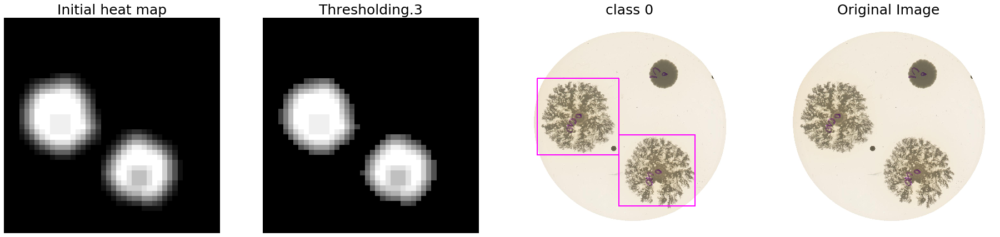

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


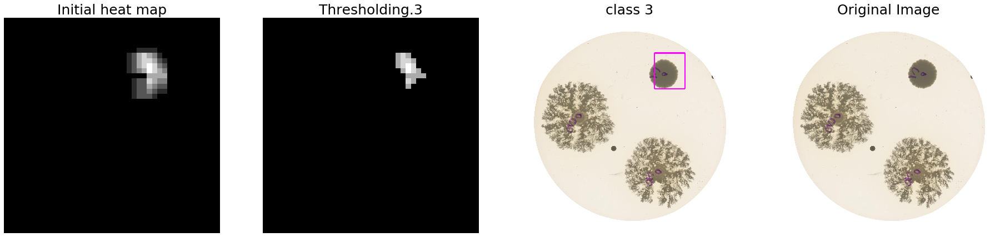

Looking for : 4


Number of boxes :1521
total of obj is :2


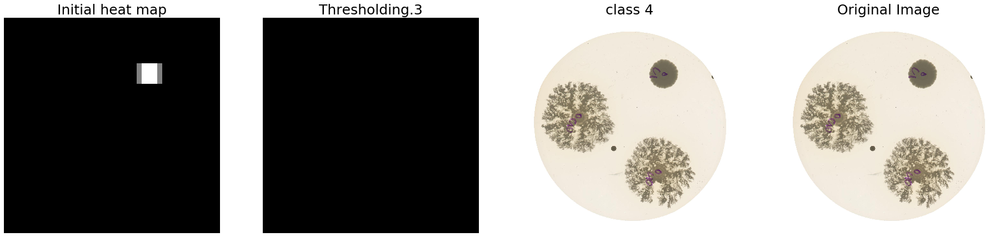

Looking for : 5


Number of boxes :1521
total of obj is :2


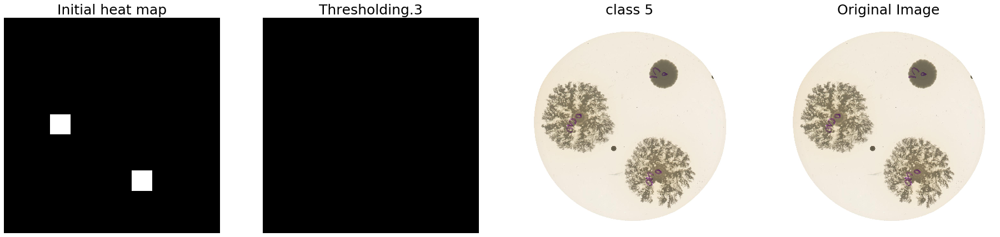

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :133


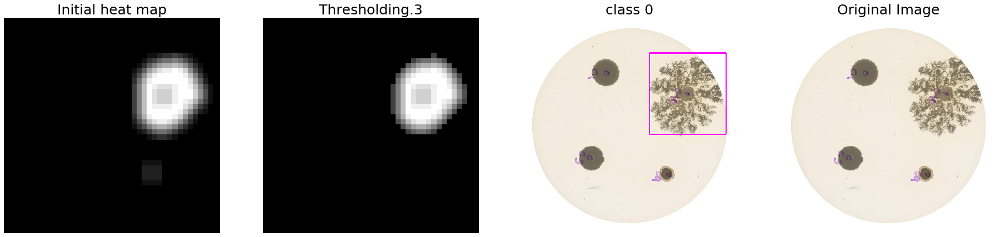

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


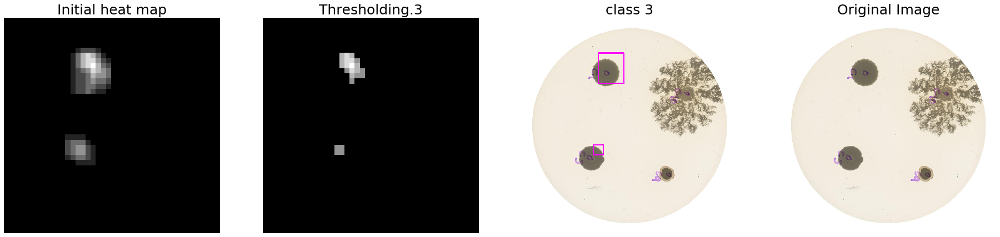

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :4


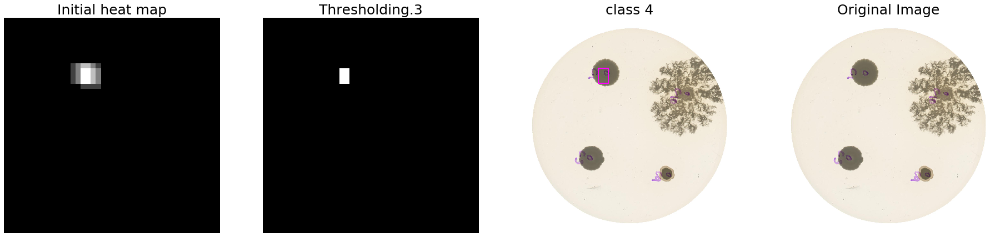

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


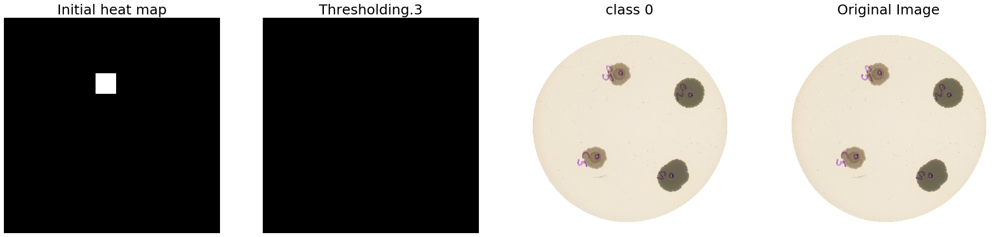

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3


Number of boxes :1521
total of obj is :34


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


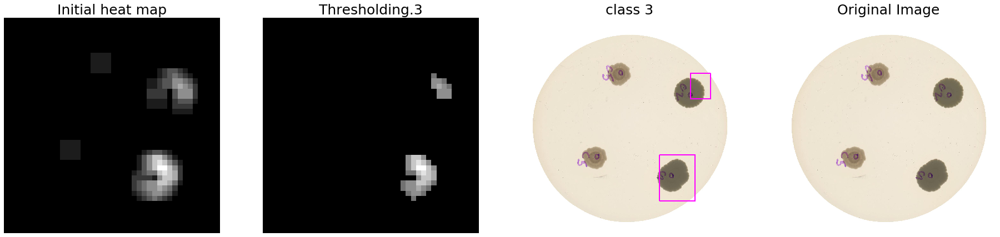

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :13


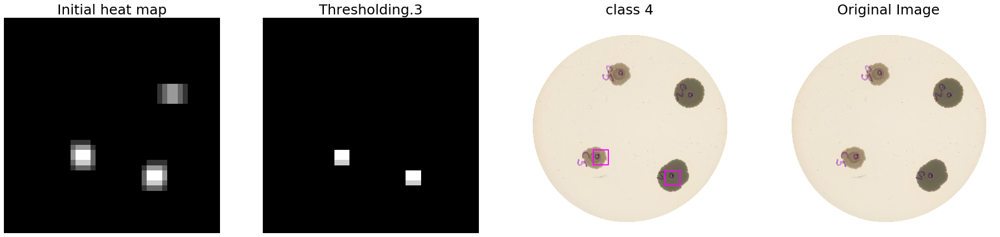

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


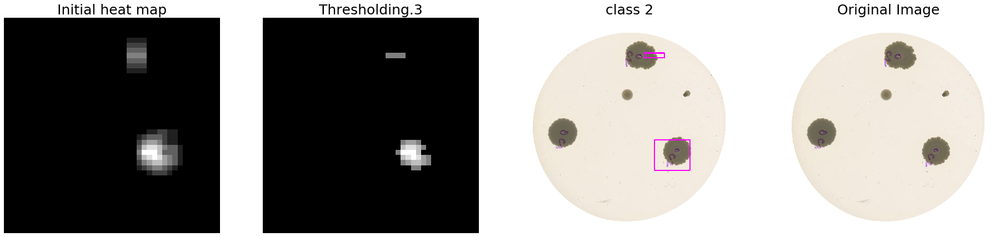

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


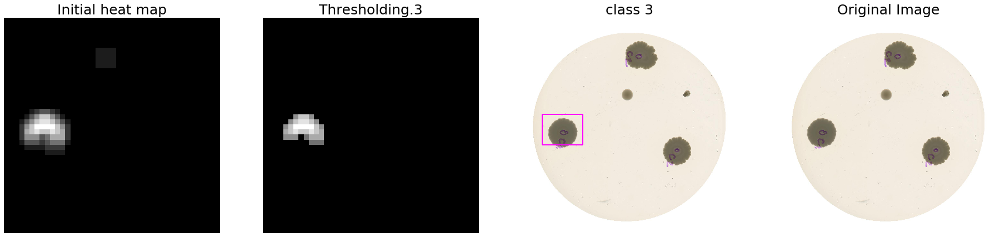

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


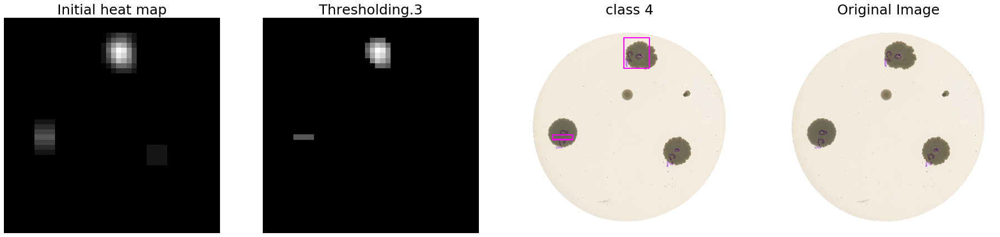

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


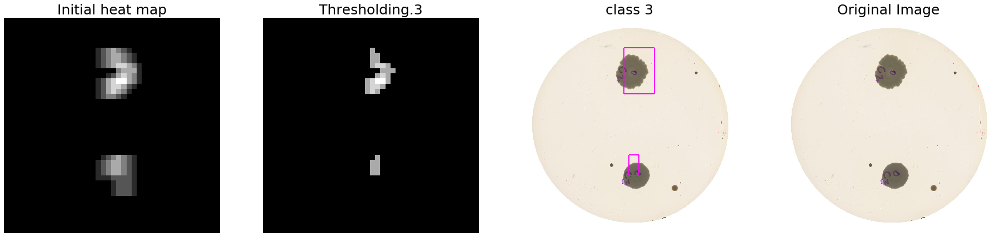

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :15


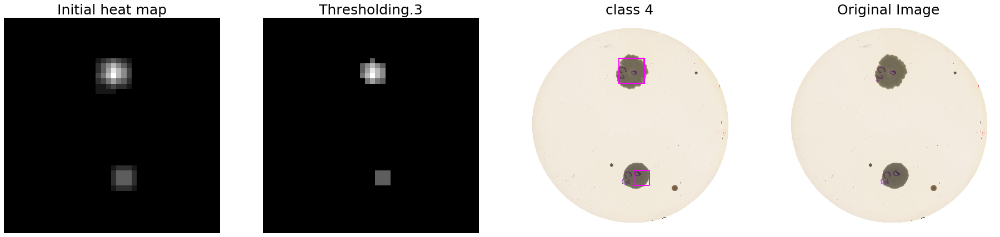

Looking for : 5


Number of boxes :1521
total of obj is :1


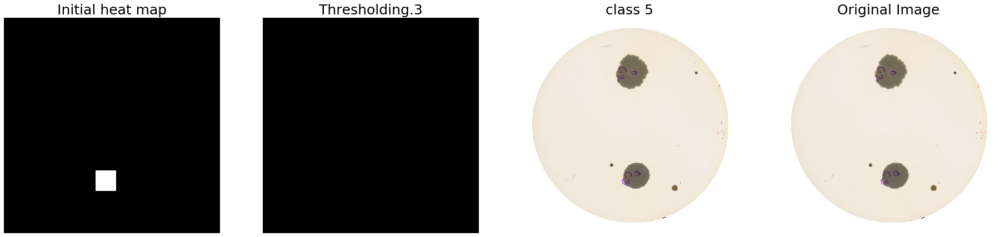

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :6


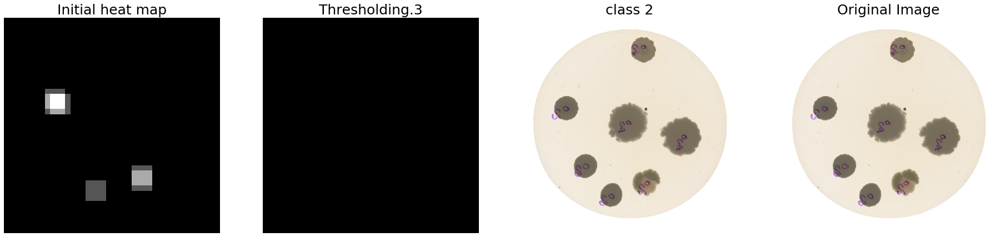

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :102


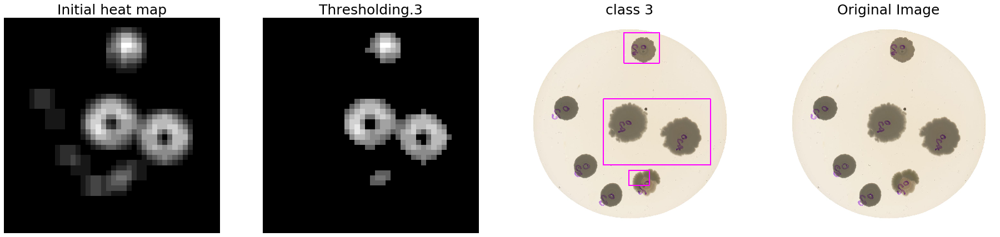

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :33


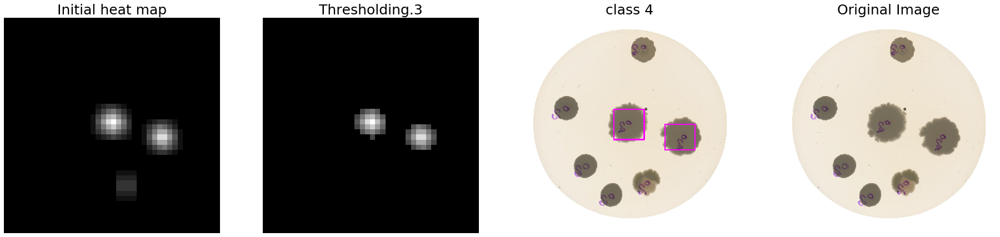

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :7


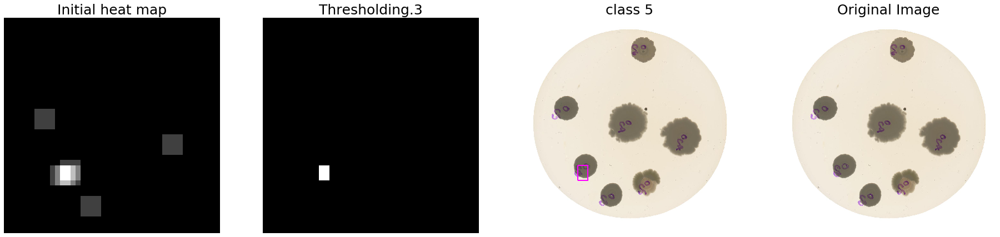

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


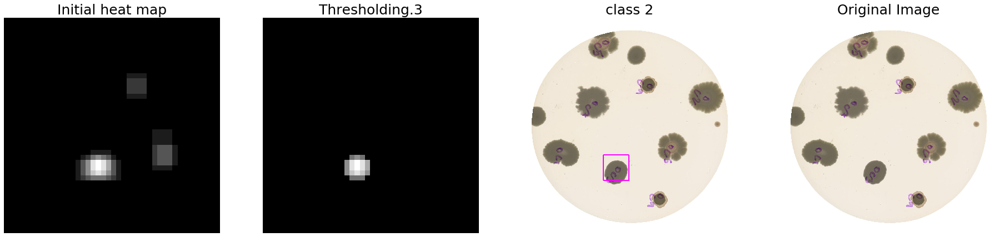

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :70


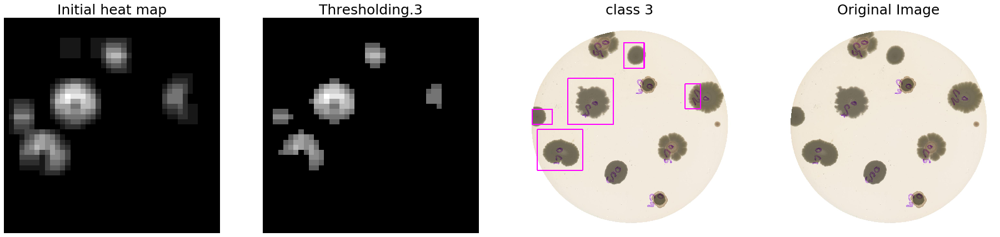

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :30


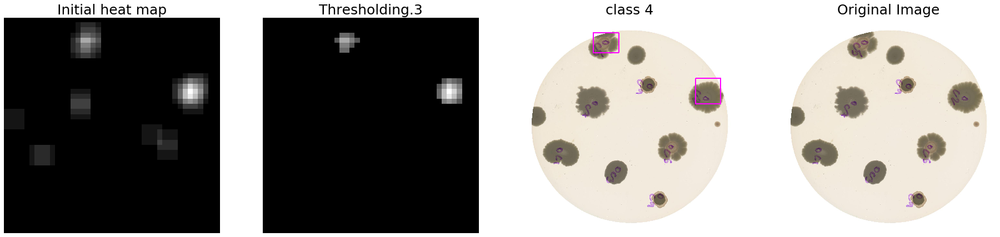

Looking for : 5


Number of boxes :1521
total of obj is :5


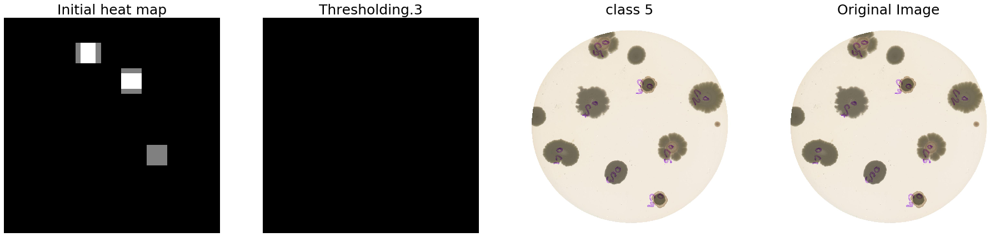

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :77


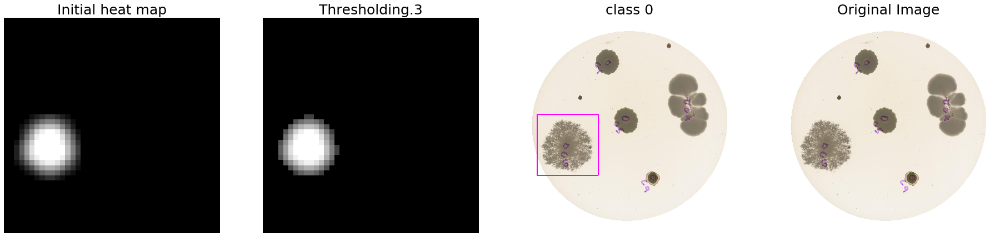

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


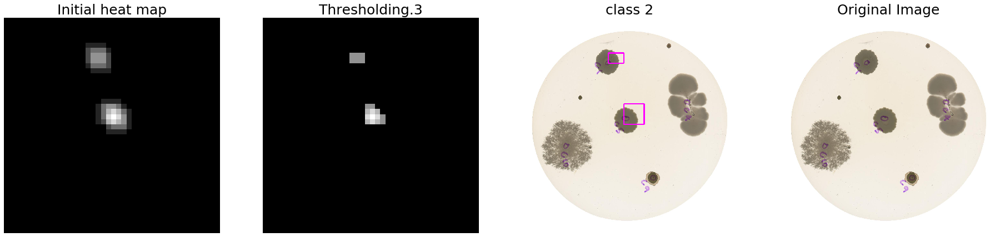

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :84


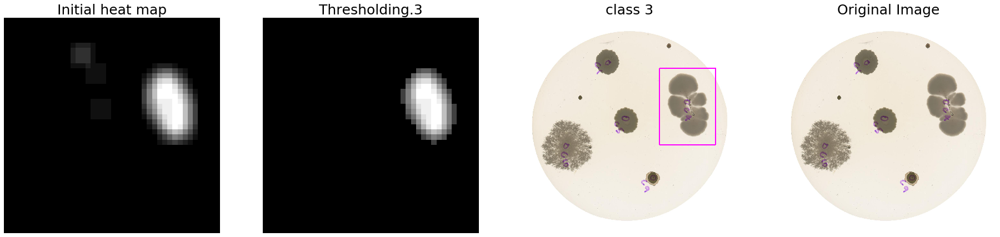

Looking for : 4


Number of boxes :1521
total of obj is :1


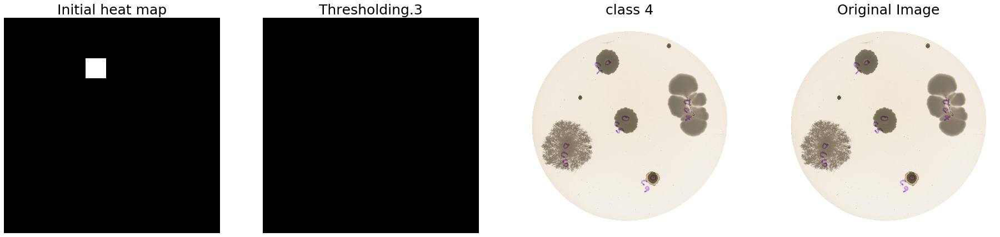

Looking for : 5


Number of boxes :1521
total of obj is :3


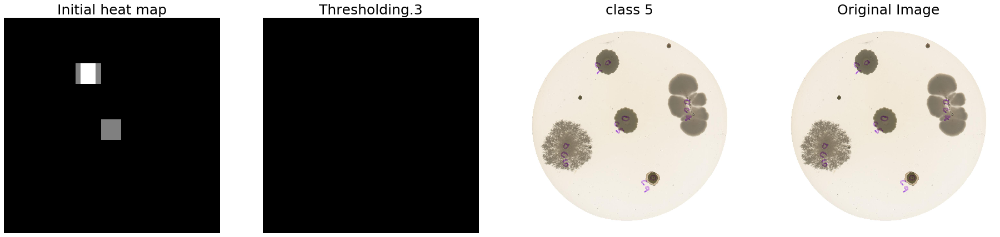

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


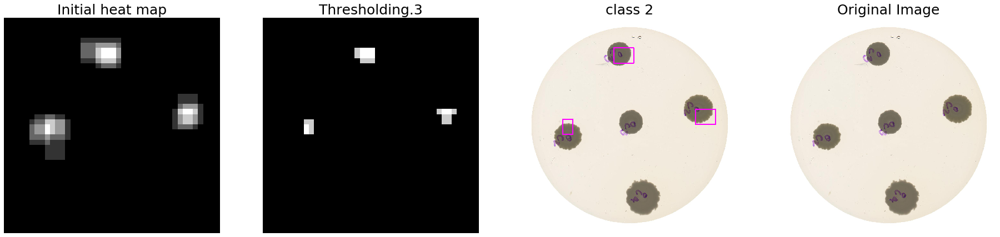

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :42


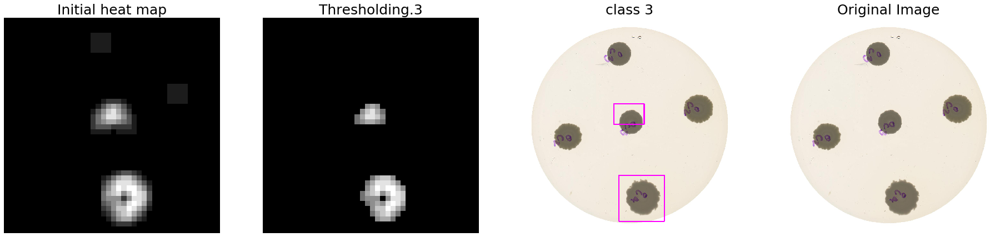

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :14


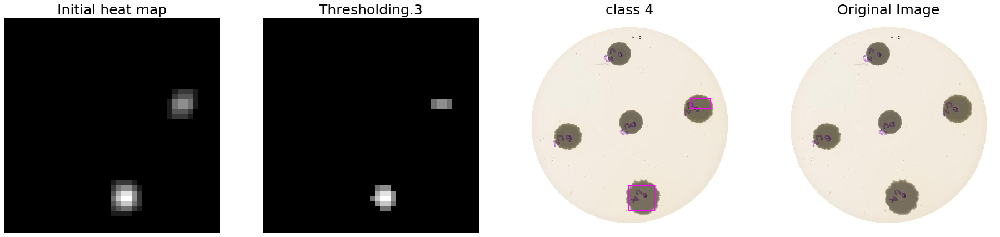

Looking for : 5


Number of boxes :1521
total of obj is :3


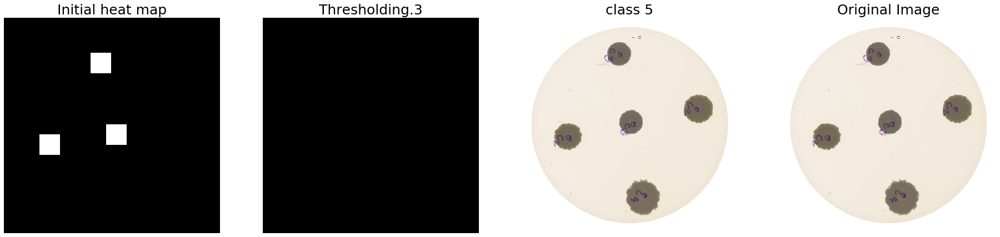

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :10


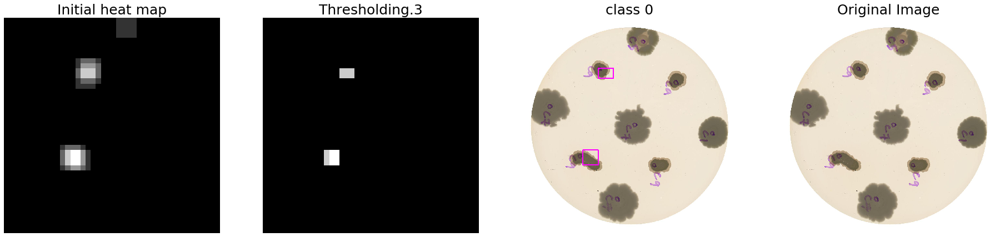

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


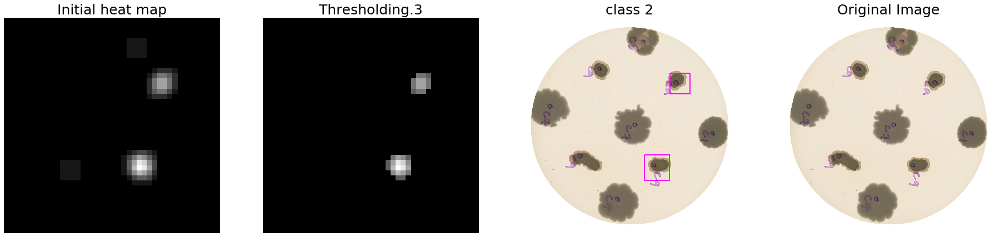

Looking for : 3


Number of boxes :1521
total of obj is :89


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


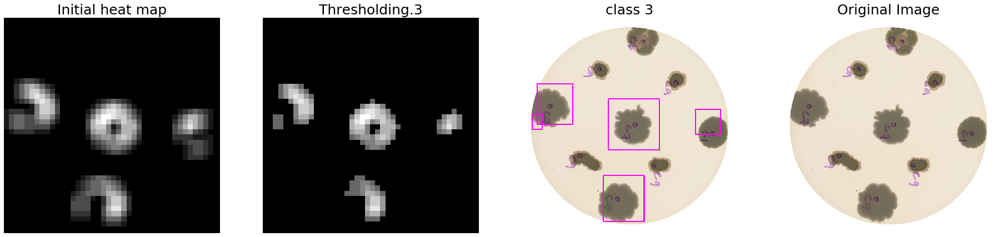

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :87


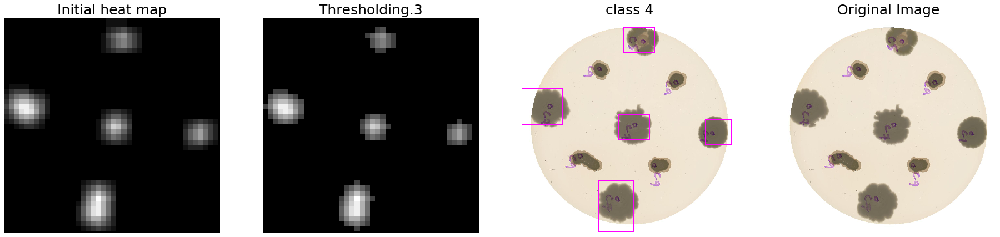

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :102


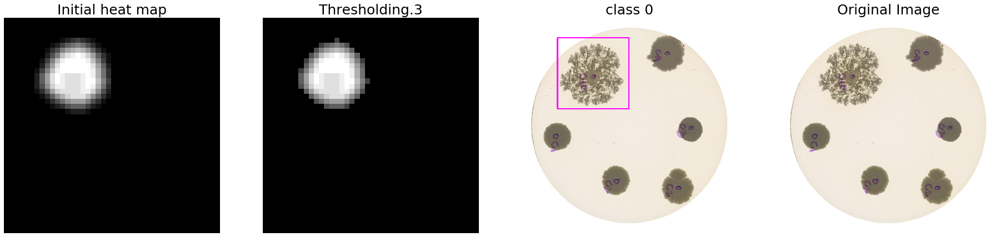

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :3


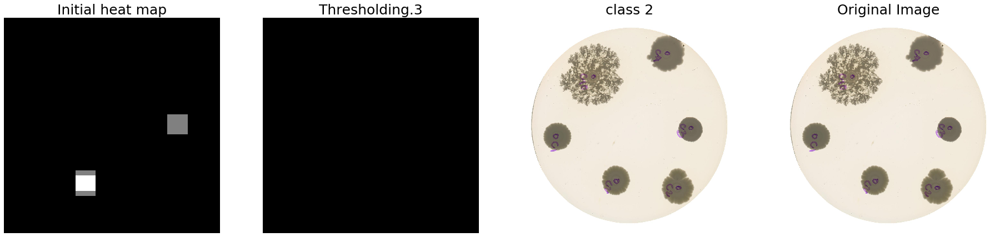

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :65


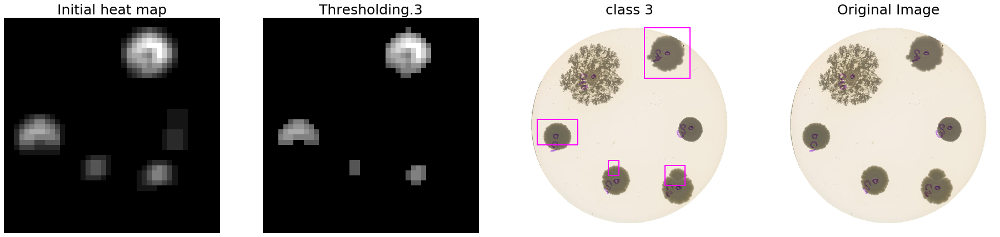

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :24


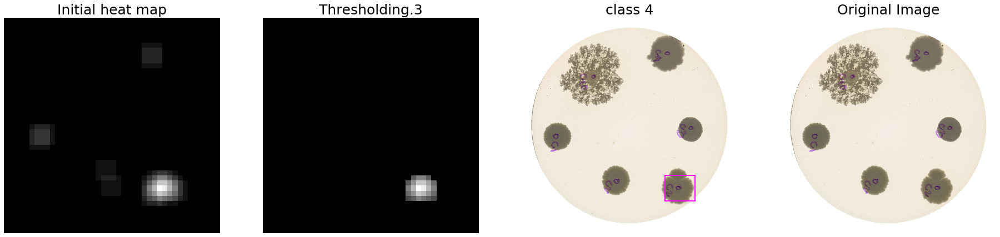

Looking for : 5


Number of boxes :1521
total of obj is :2


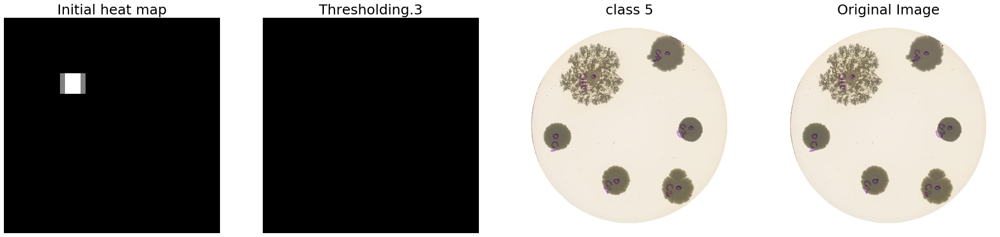

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


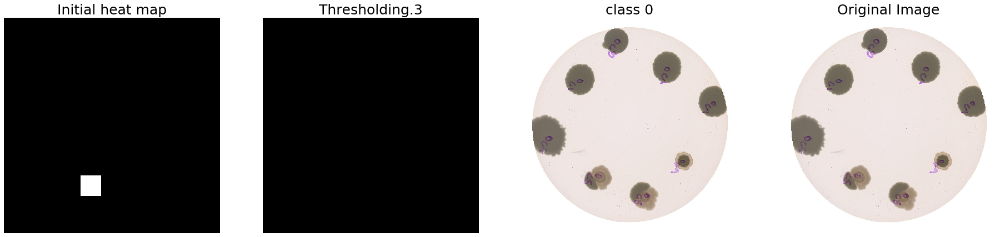

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :28


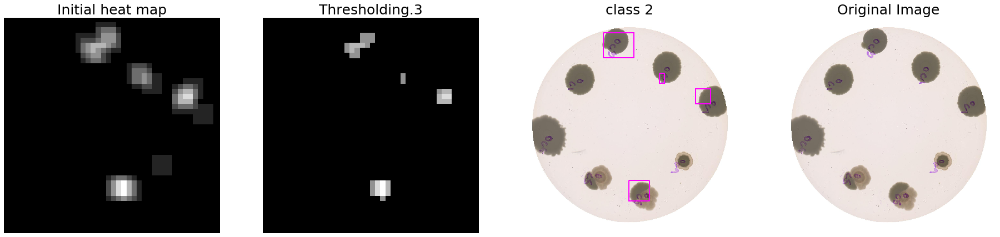

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :71


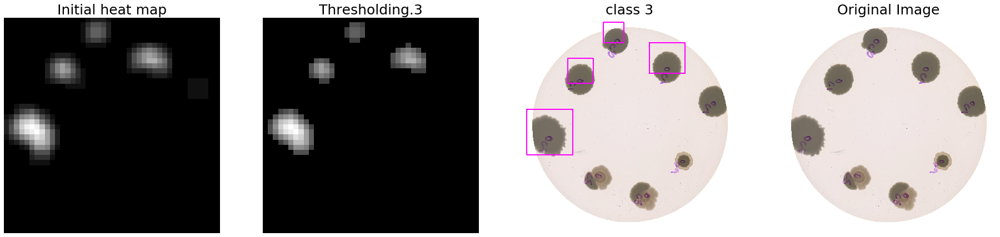

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


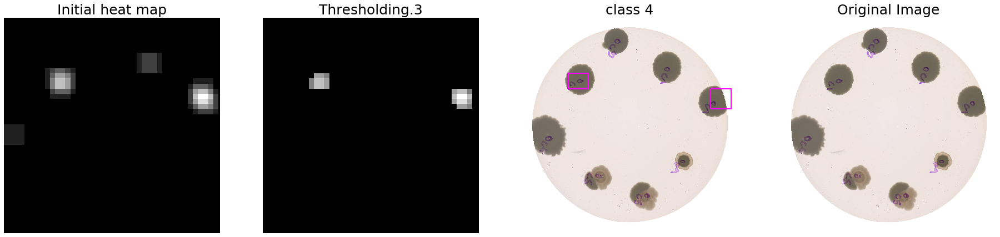

Looking for : 5


Number of boxes :1521
total of obj is :4


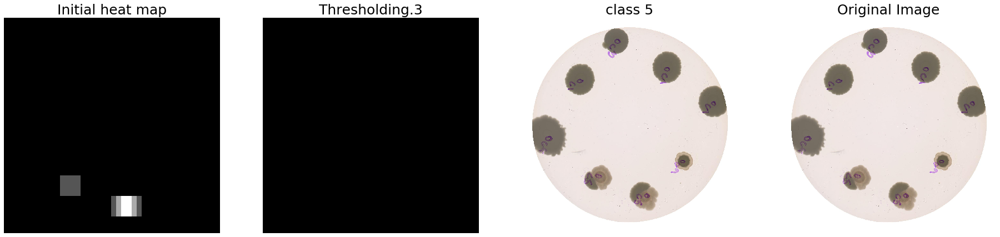

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :56


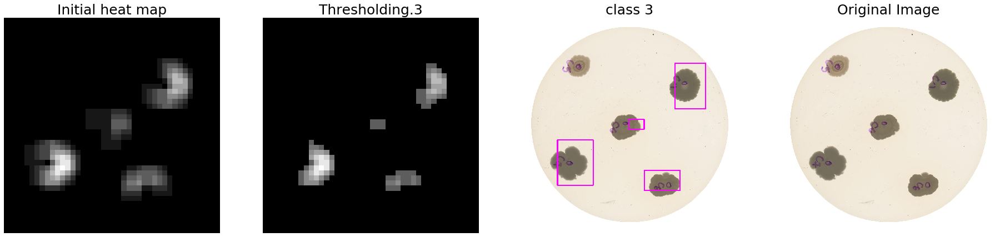

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :14


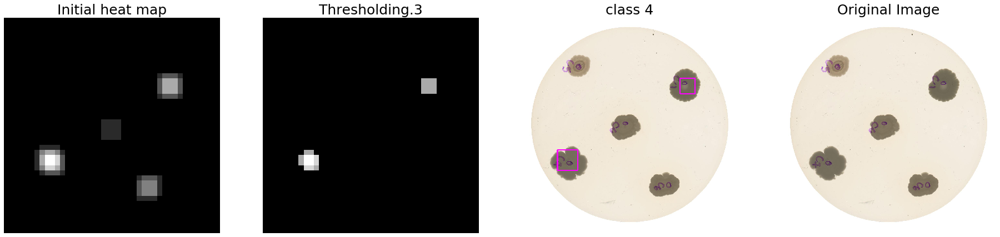

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


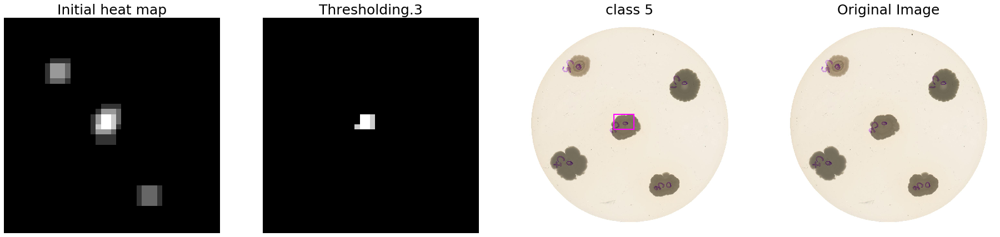

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :153


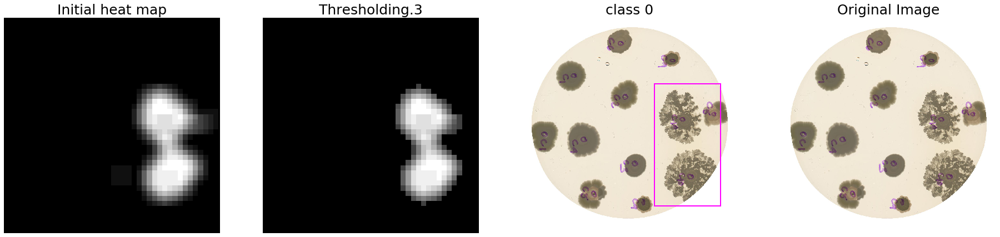

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


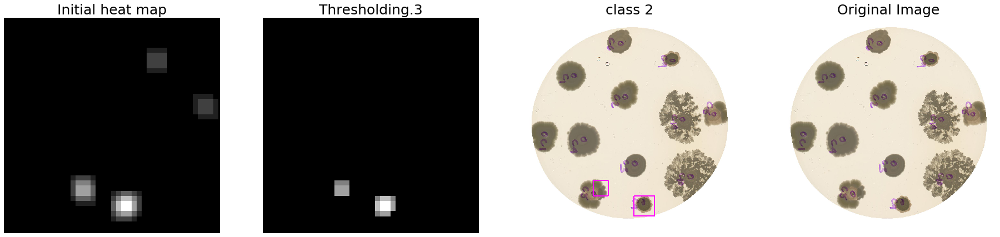

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :61


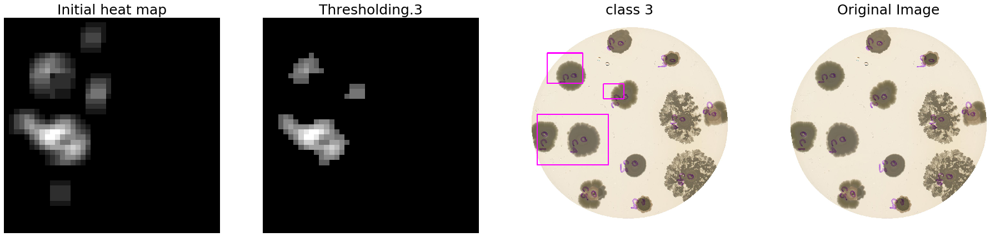

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :30


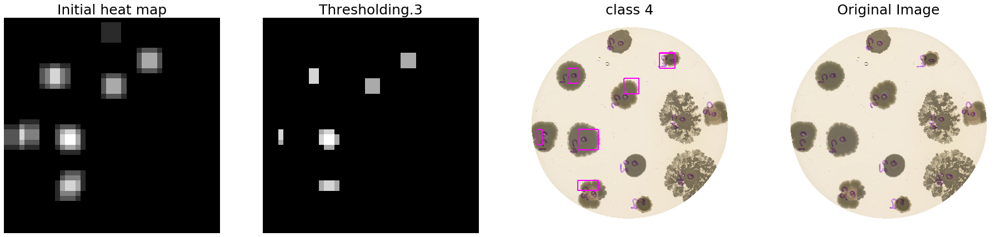

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


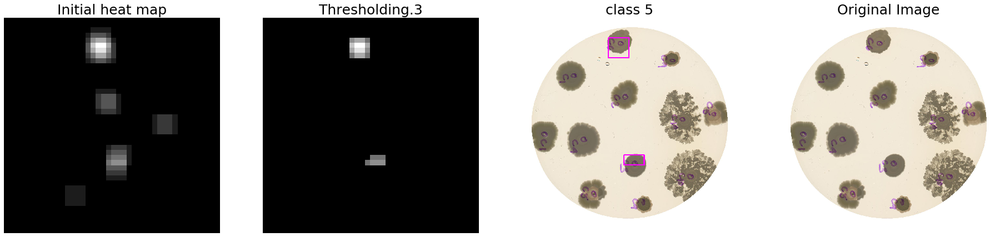

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :1


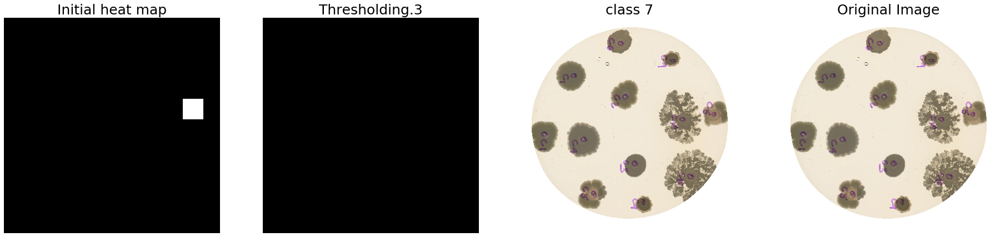

Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :50


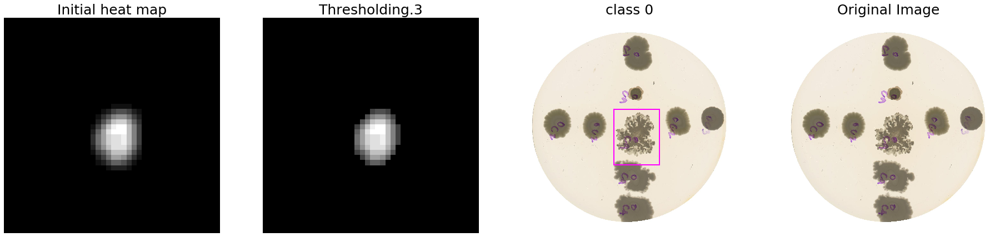

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


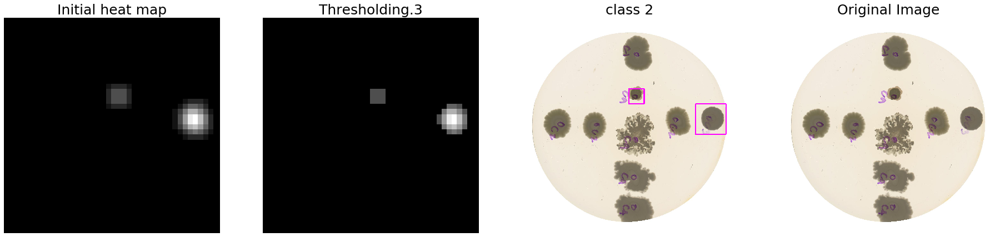

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :100


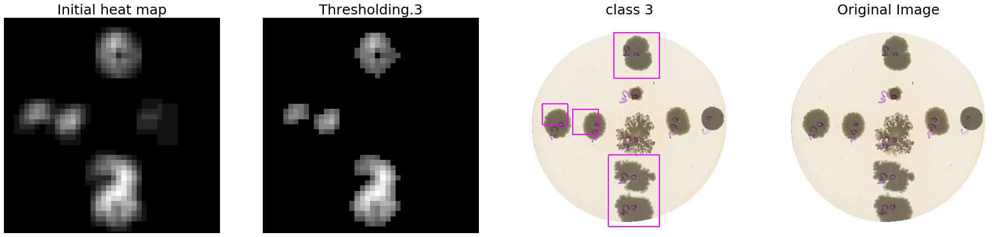

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :25


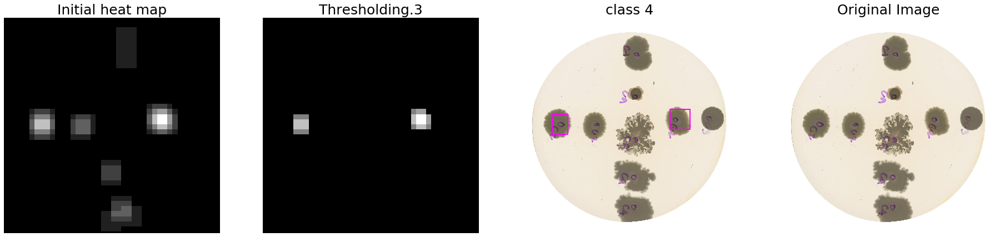

Looking for : 5


Number of boxes :1521
total of obj is :2


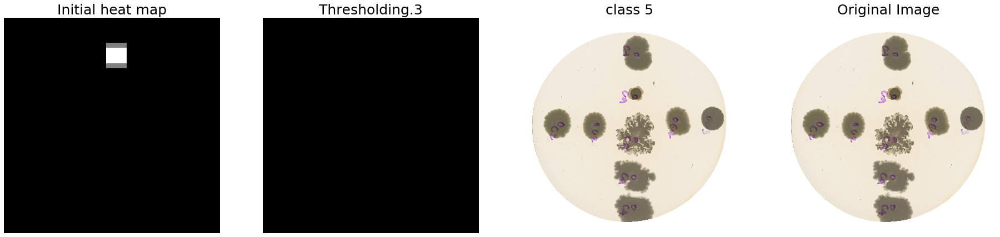

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :12


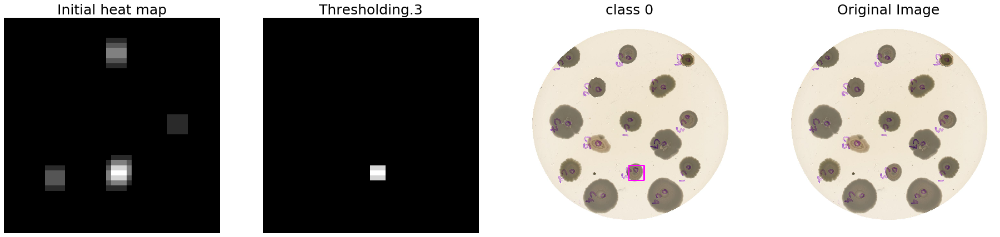

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


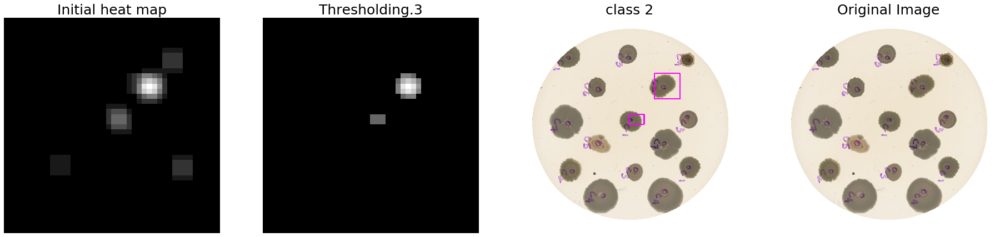

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :153


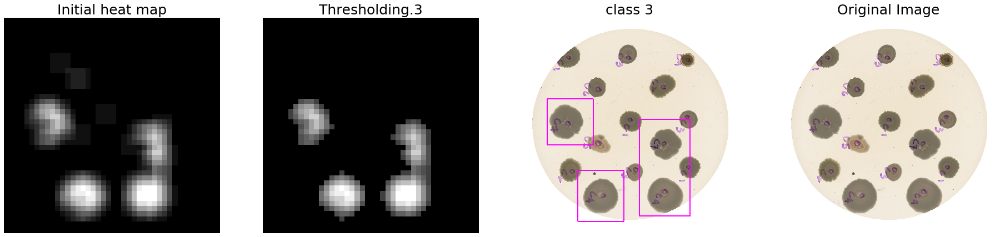

Looking for : 4


Number of boxes :1521
total of obj is :1


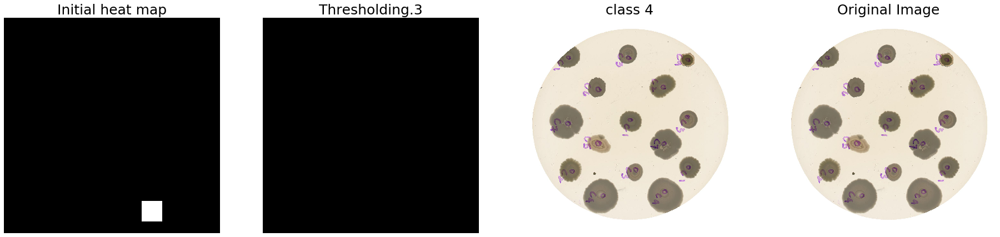

Looking for : 5


Number of boxes :1521
total of obj is :10


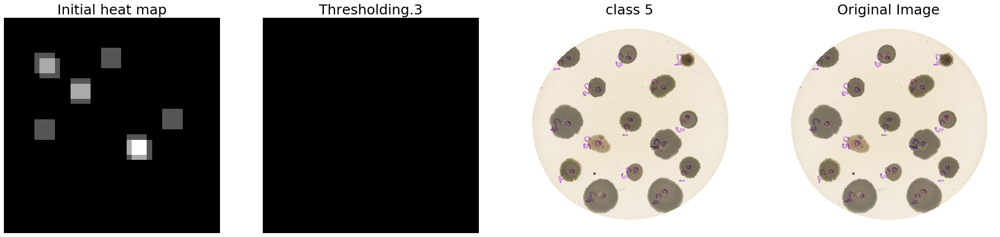

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :3


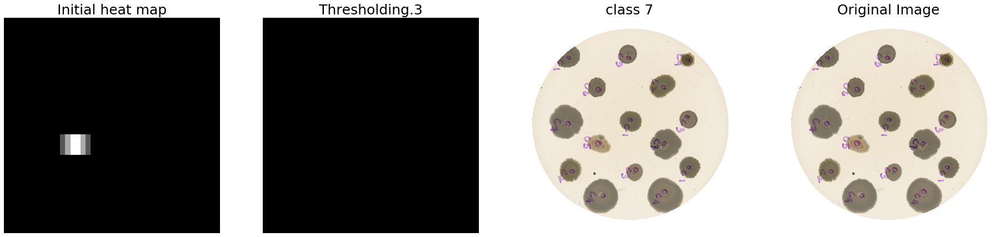

Looking for : 0


Number of boxes :1521
total of obj is :5


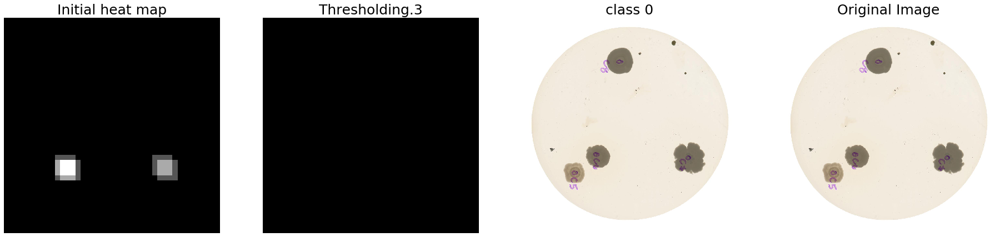

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :2


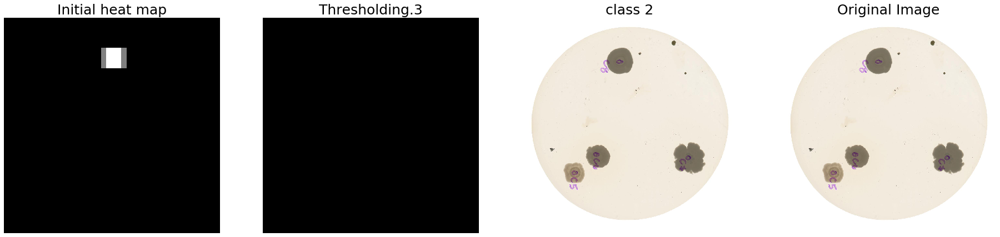

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :39


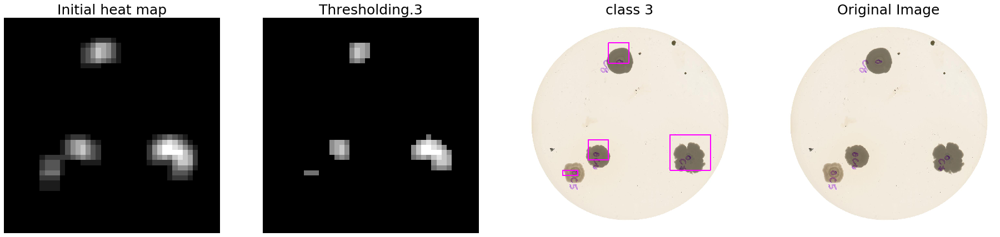

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


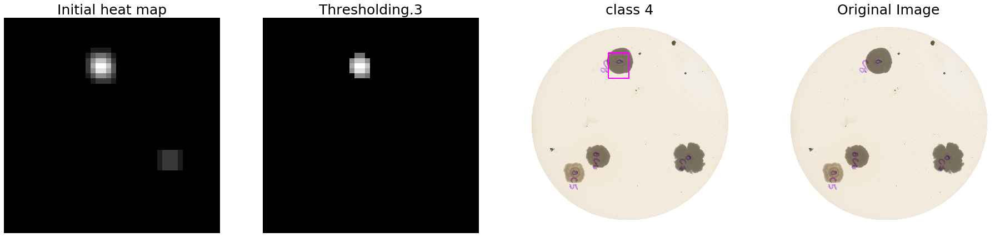

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :6


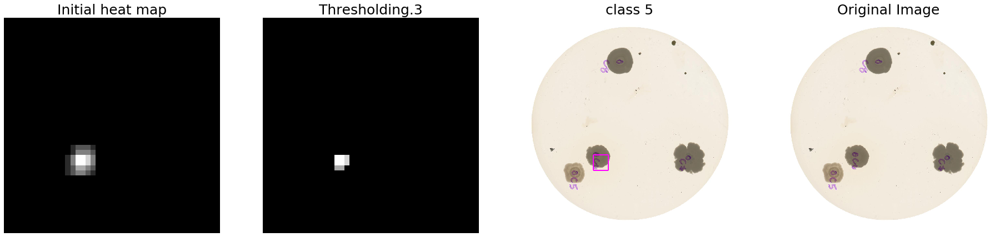

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :139


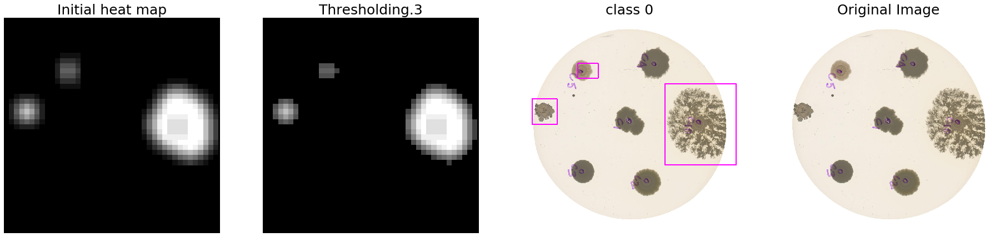

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


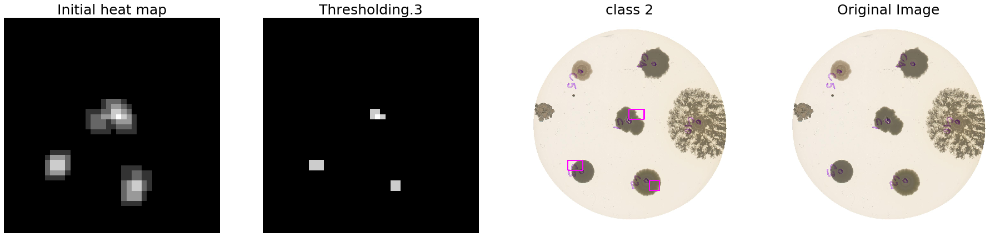

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :31


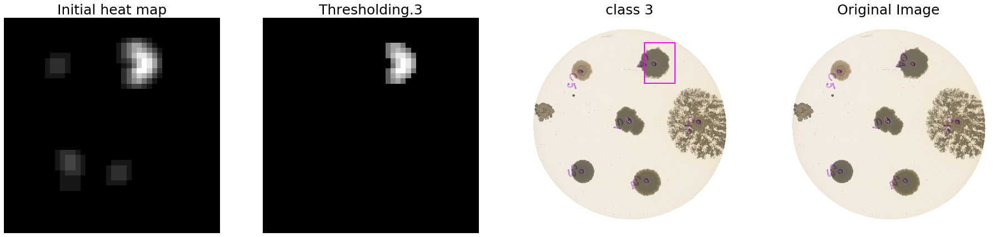

Looking for : 4


Number of boxes :1521
total of obj is :5


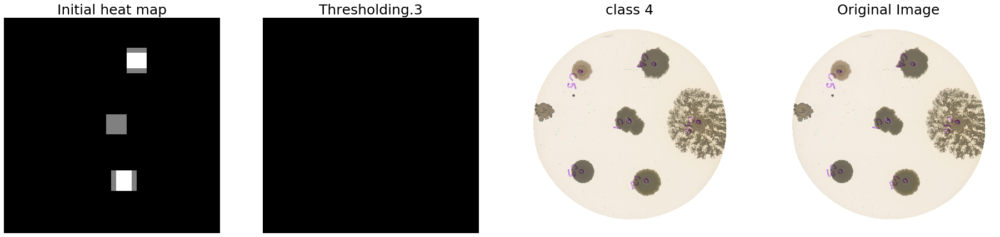

Looking for : 5


Number of boxes :1521
total of obj is :5


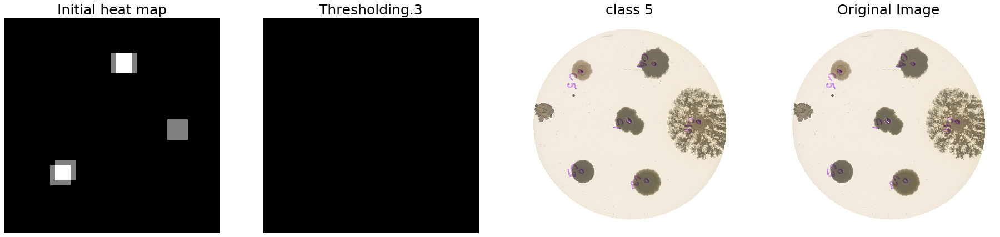

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :24


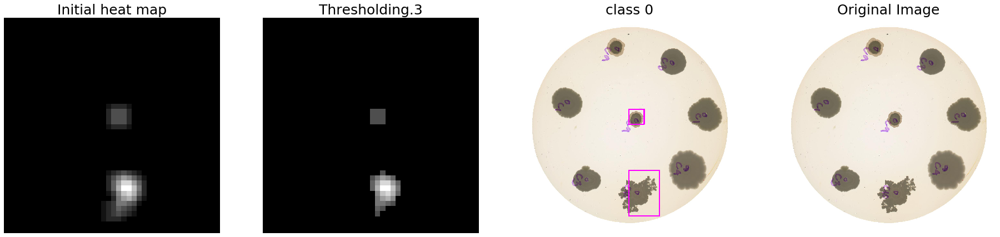

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :6


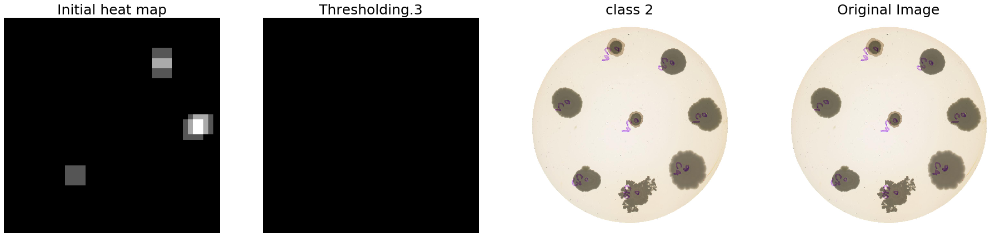

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :88


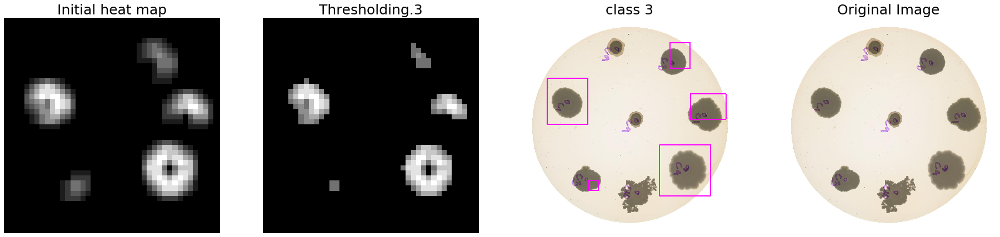

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


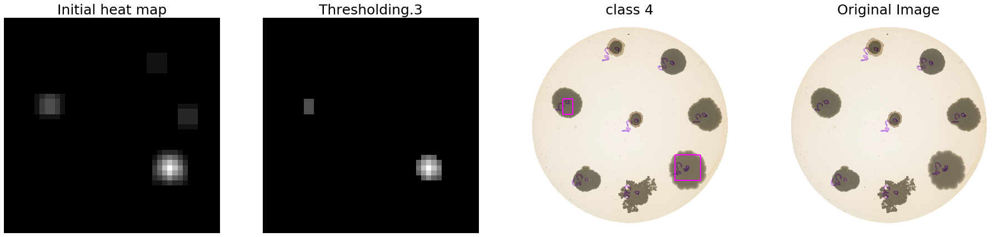

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :13


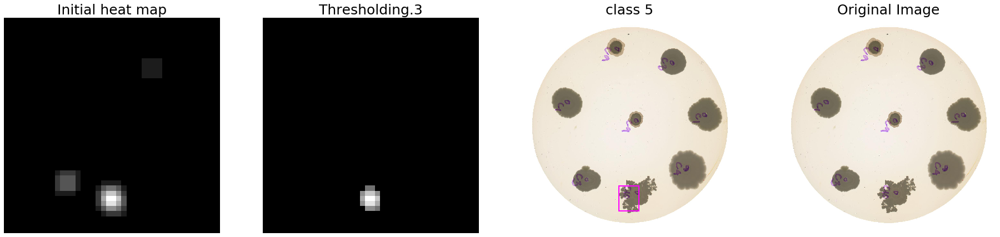

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :2


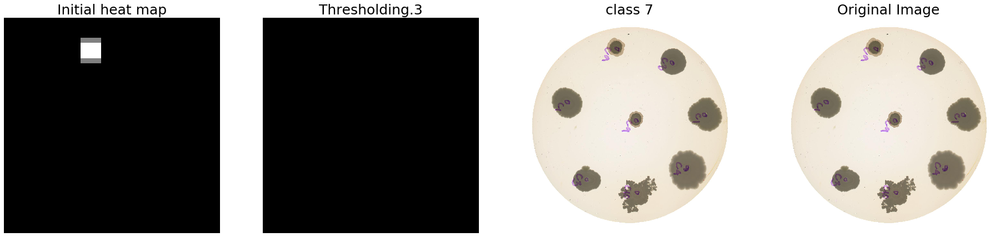

Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :57


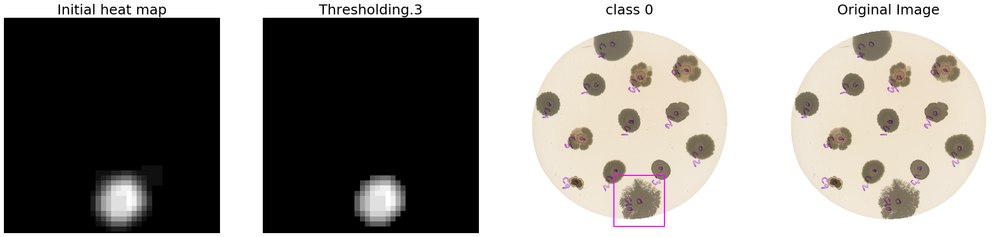

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :83


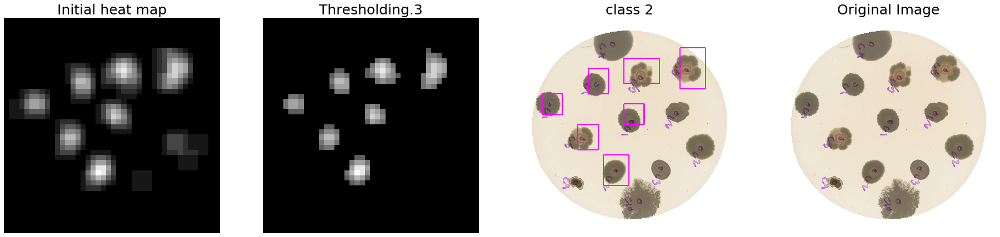

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :35


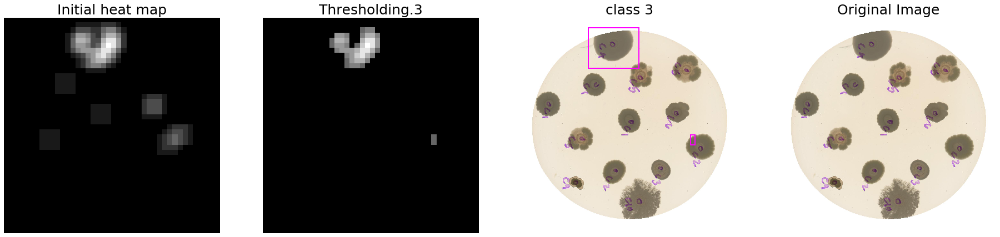

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :24


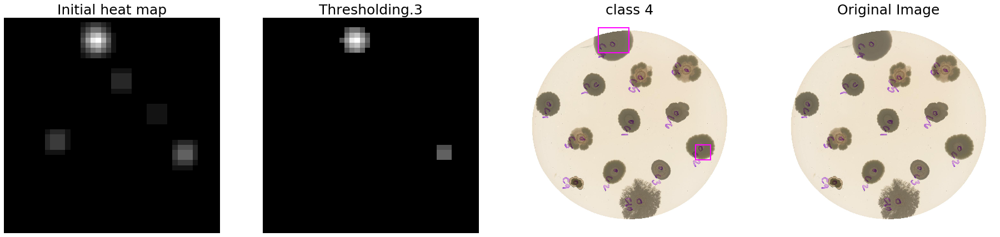

Looking for : 5


Number of boxes :1521
total of obj is :6


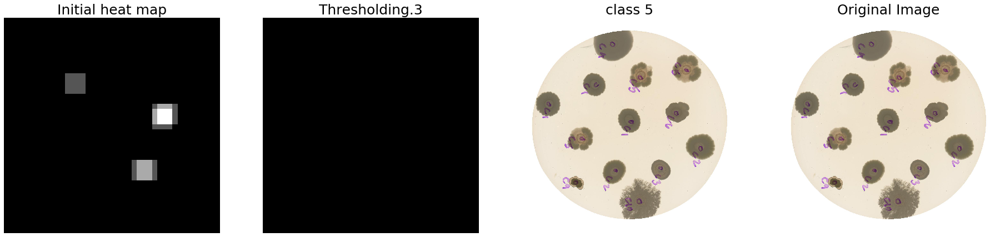

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :41


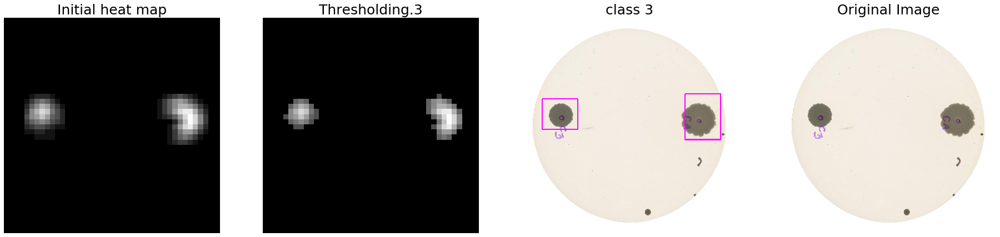

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :9


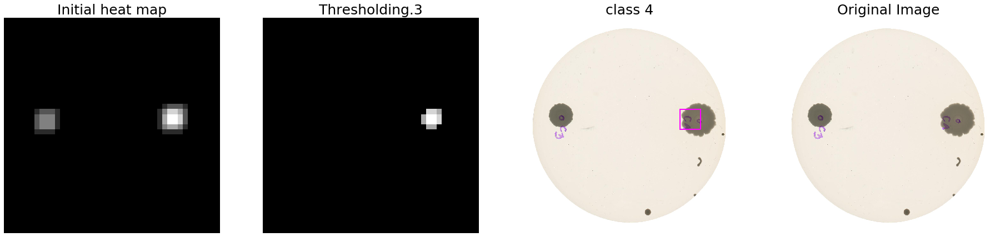

Looking for : 5


Number of boxes :1521
total of obj is :1


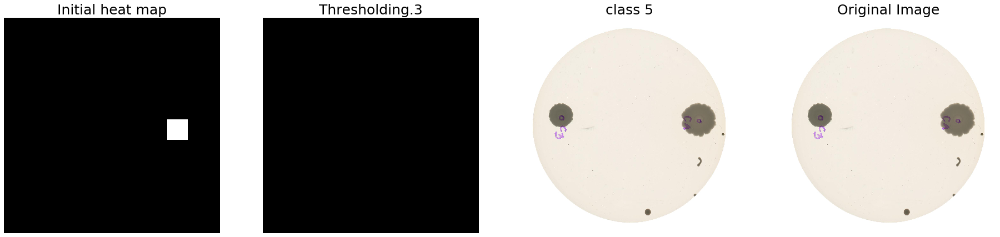

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :6


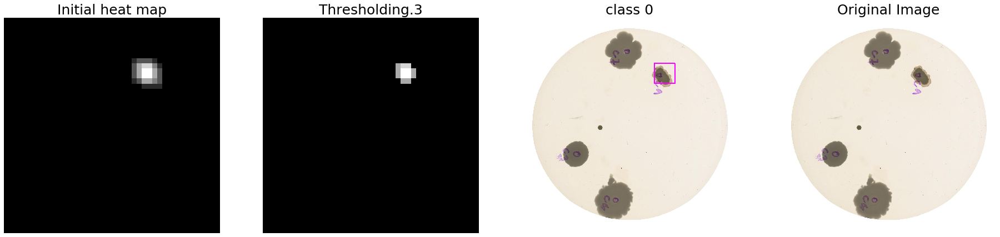

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :4


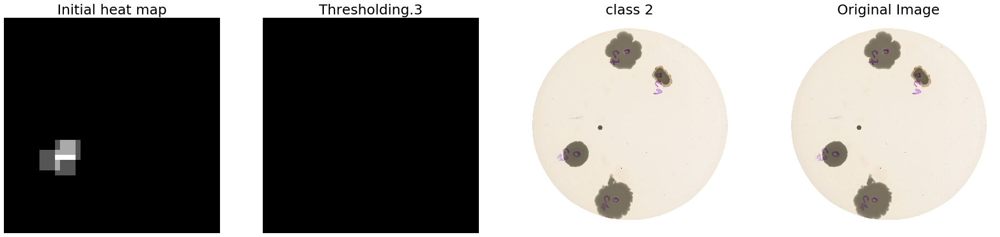

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :67


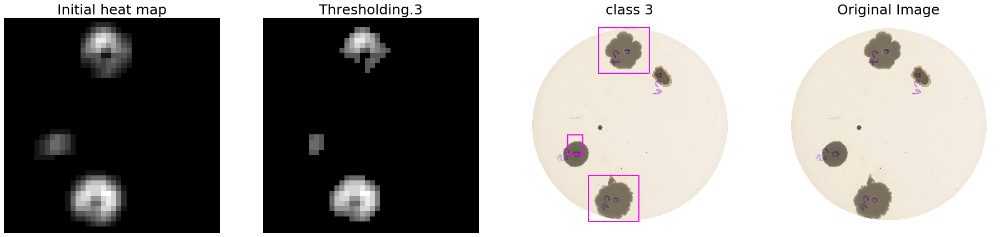

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


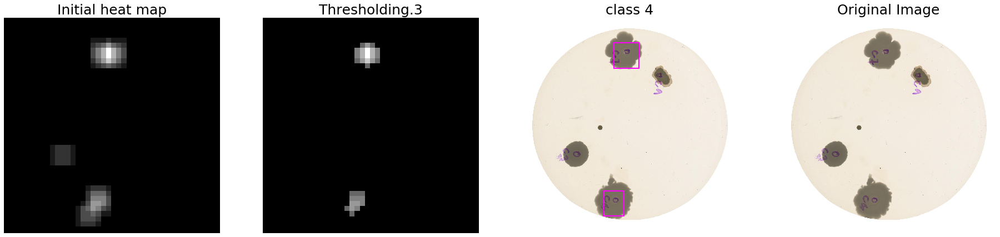

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :14


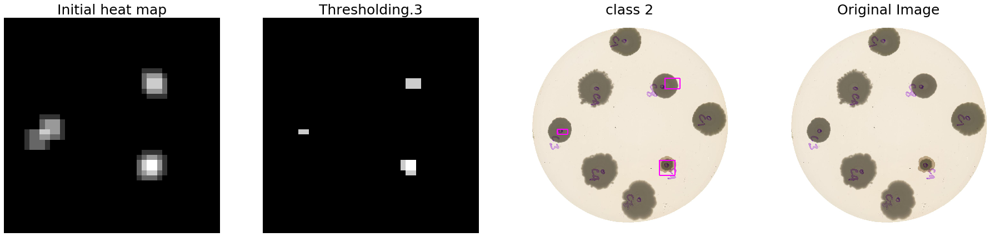

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :121


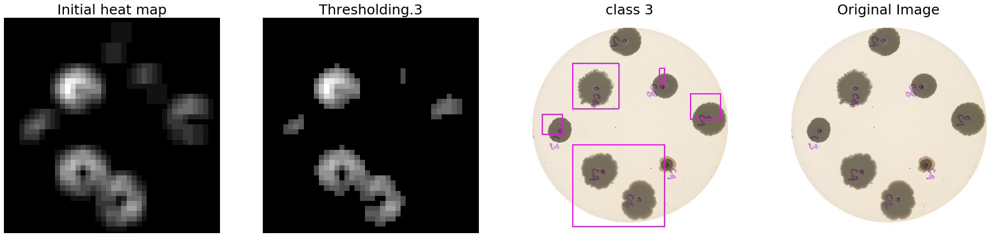

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :53


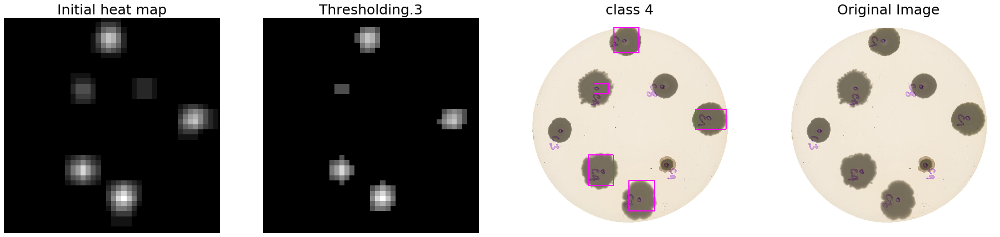

Looking for : 5


Number of boxes :1521
total of obj is :1


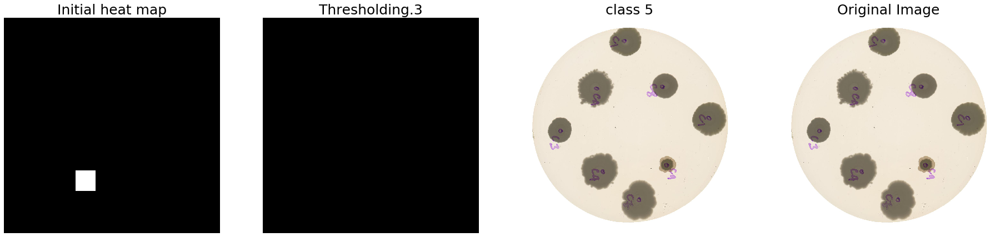

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :2


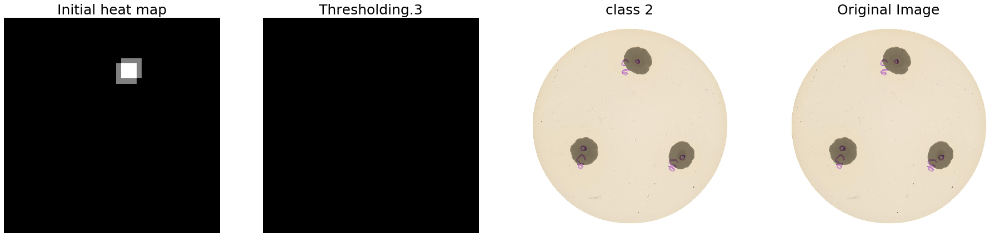

Looking for : 3


Number of boxes :1521
total of obj is :6


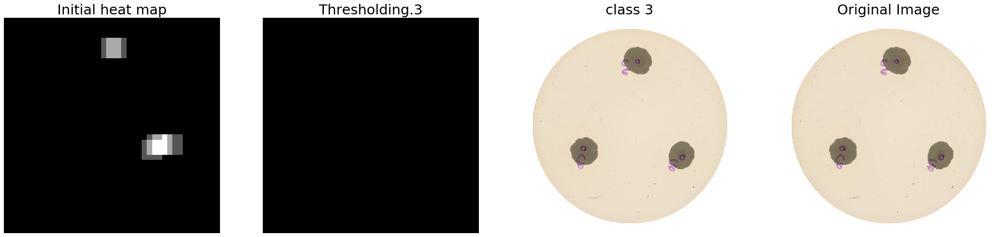

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :13


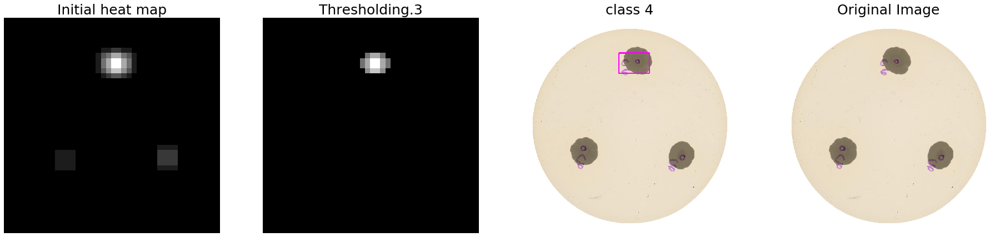

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


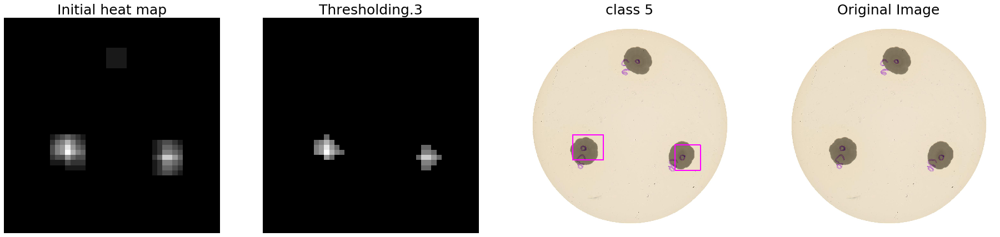

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :2


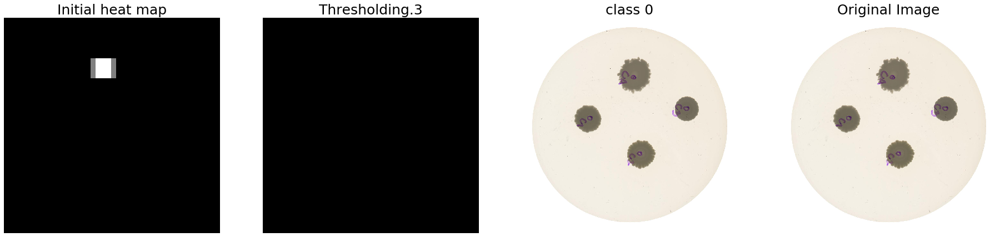

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :9


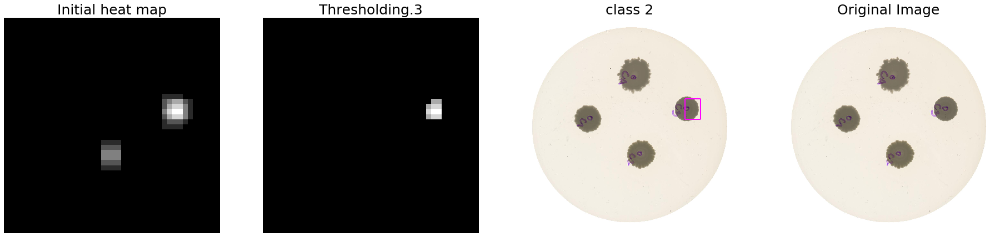

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :34


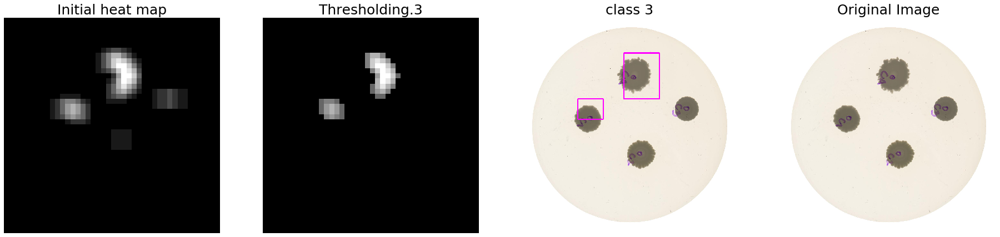

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :15


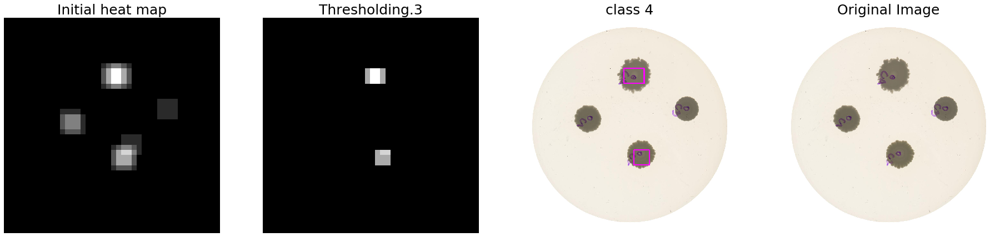

Looking for : 5


Number of boxes :1521
total of obj is :1


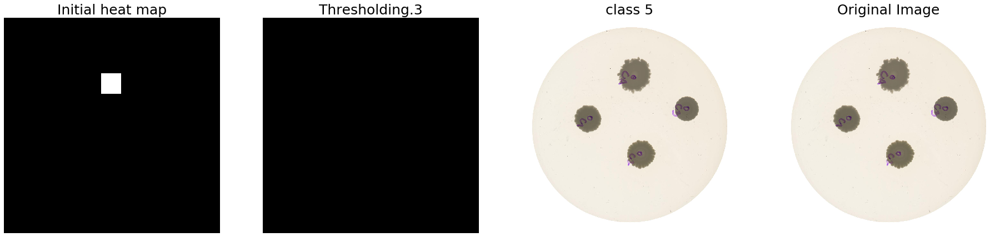

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :91


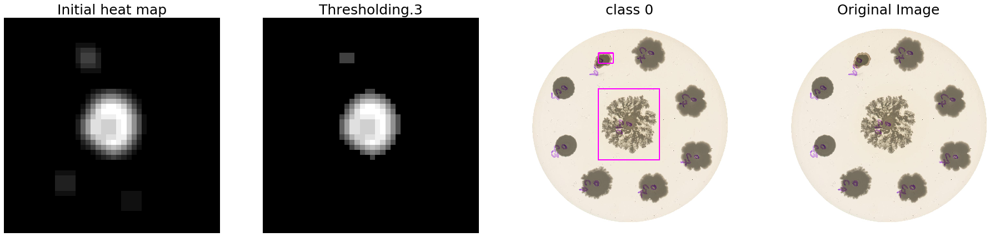

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :10


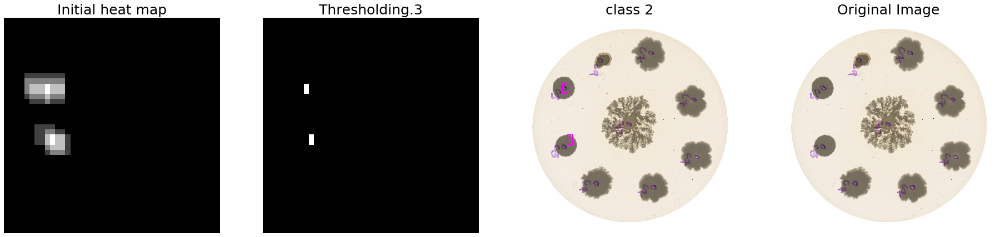

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :110


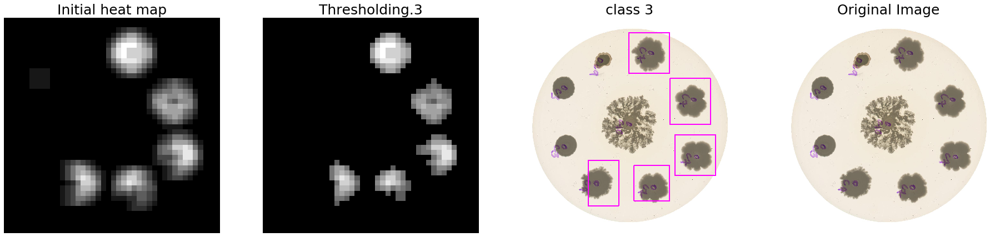

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


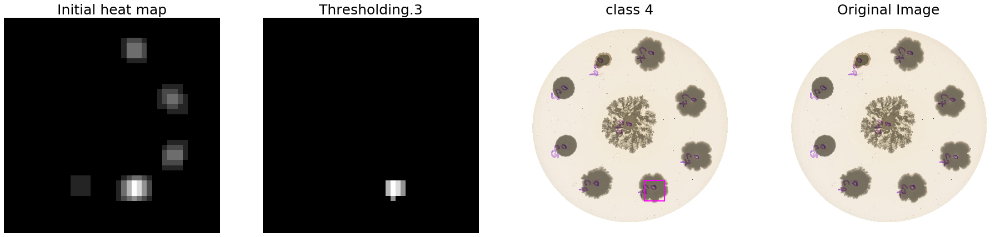

Looking for : 5


Number of boxes :1521
total of obj is :8


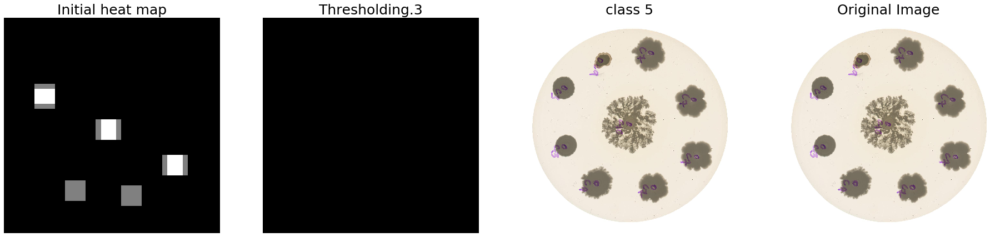

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :2


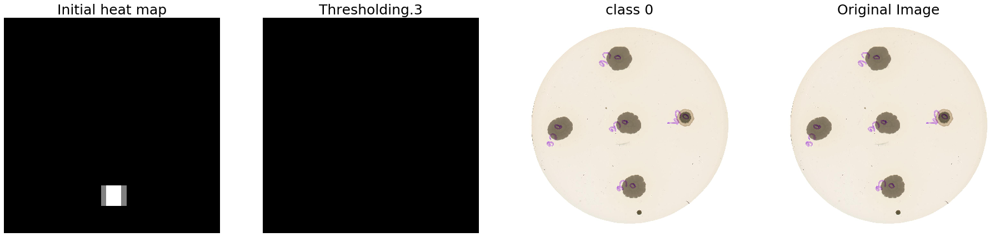

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :35


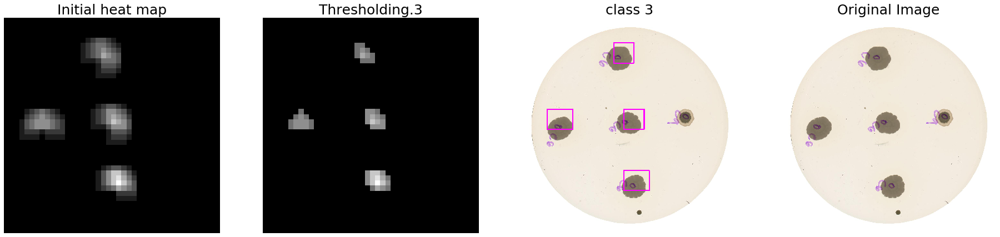

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


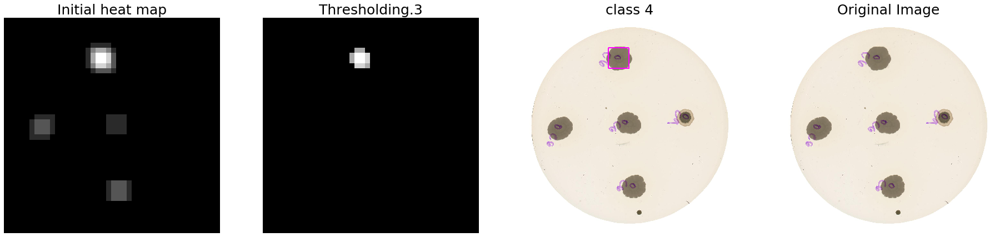

Looking for : 5


Number of boxes :1521
total of obj is :5


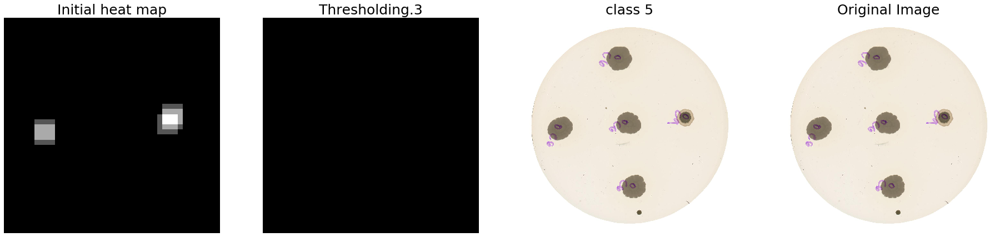

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :4


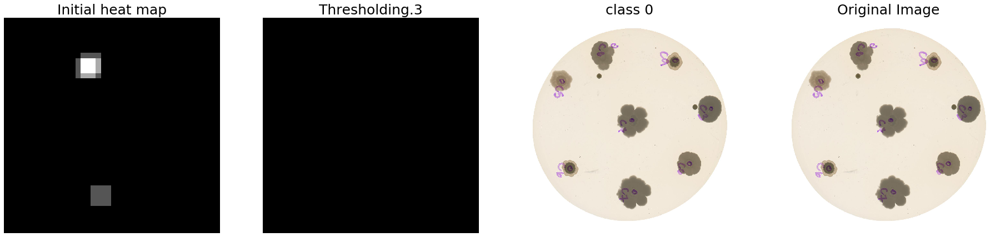

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :3


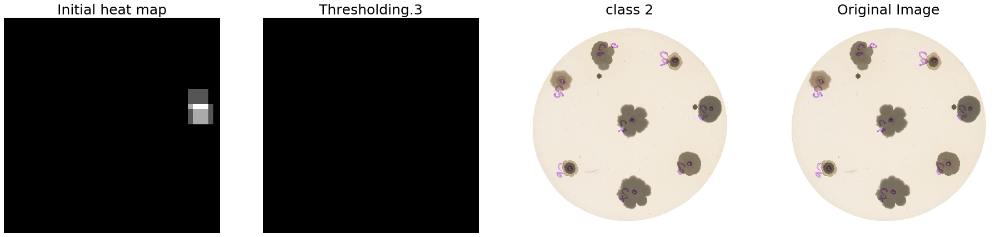

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :56


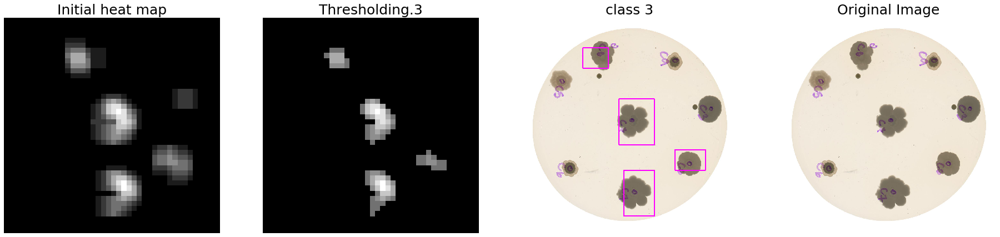

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


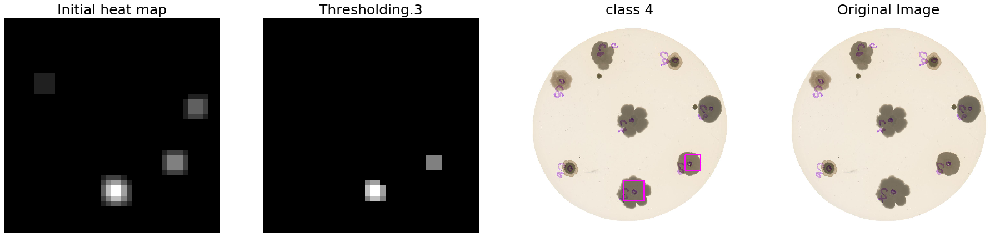

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :6


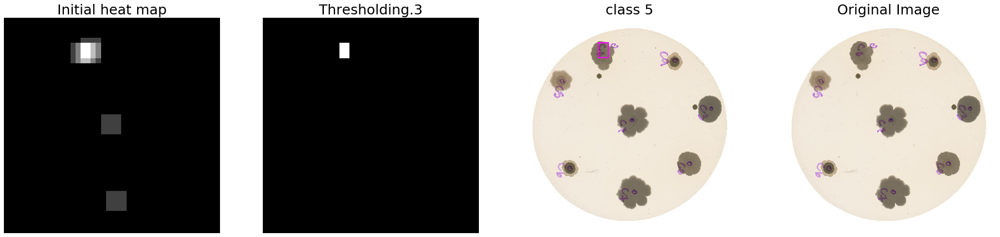

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :260


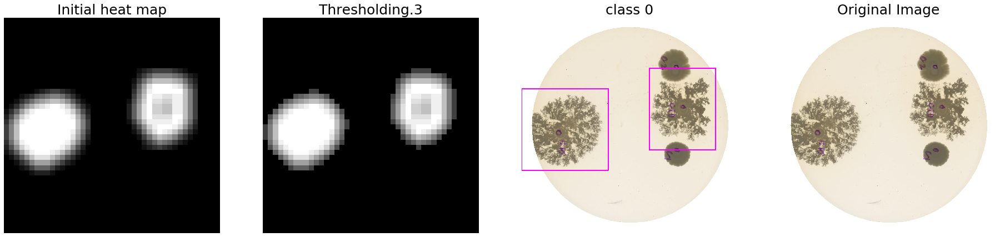

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


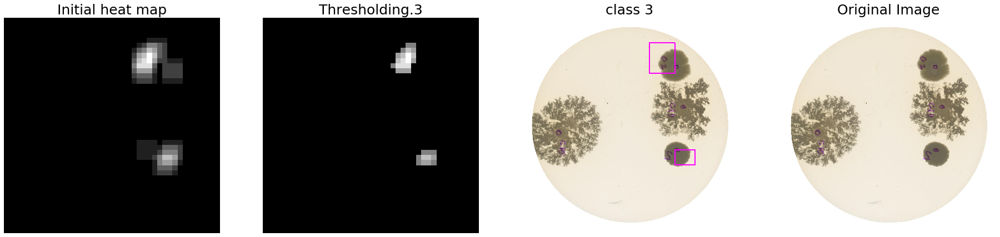

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


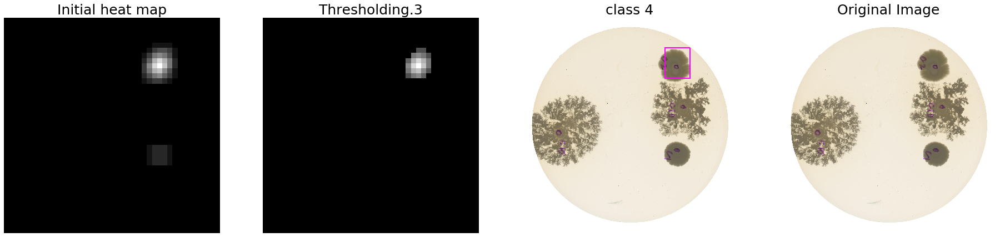

Looking for : 5


Number of boxes :1521
total of obj is :2


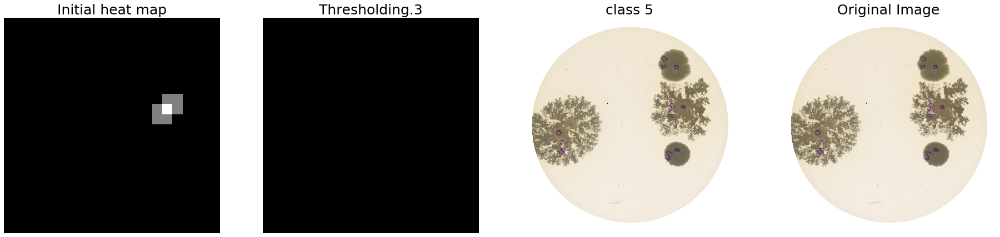

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


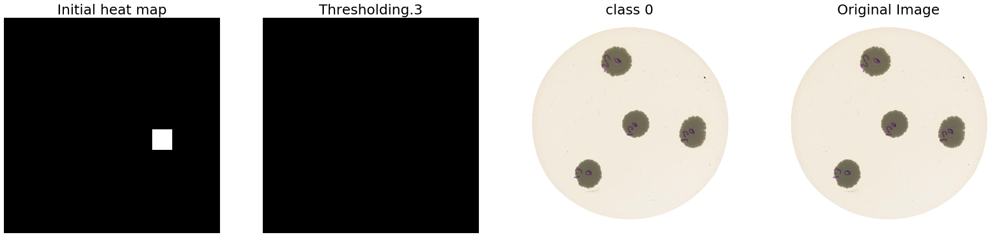

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :47


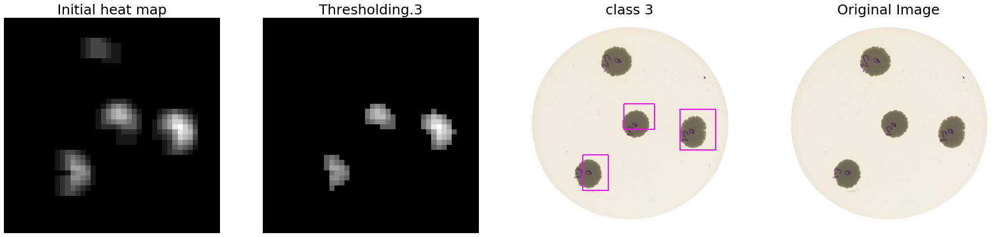

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


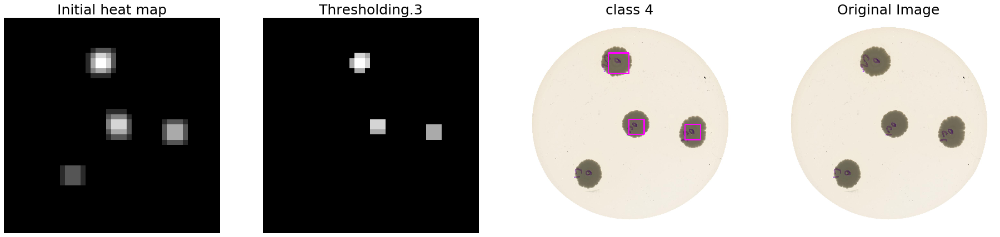

Looking for : 5


Number of boxes :1521
total of obj is :1


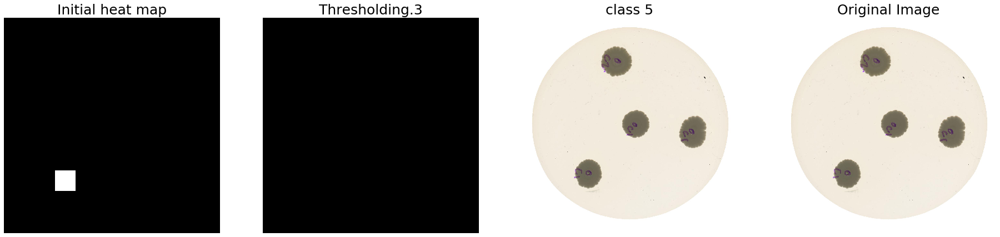

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :248


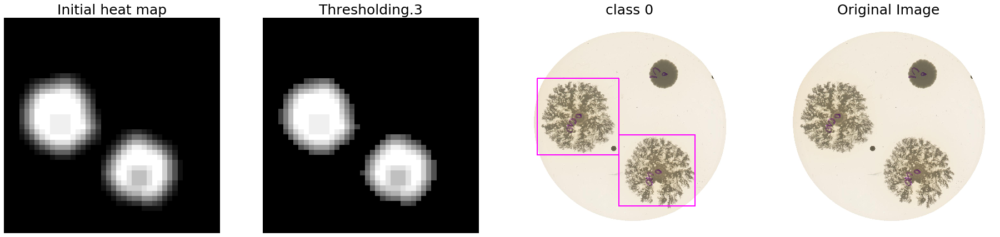

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


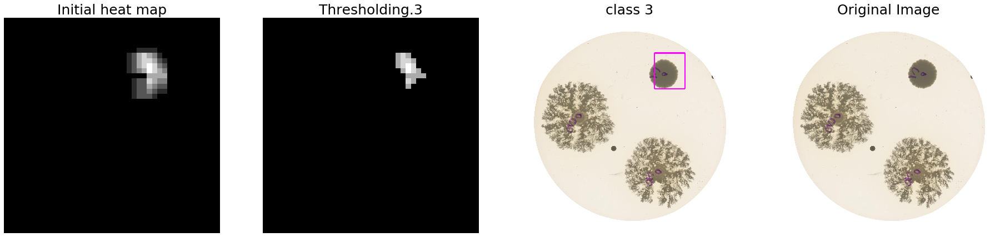

Looking for : 4


Number of boxes :1521
total of obj is :2


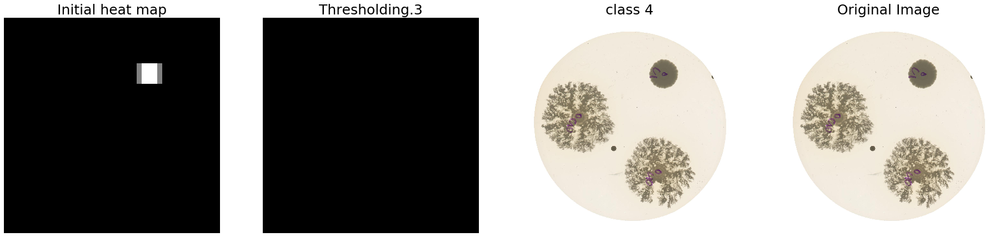

Looking for : 5


Number of boxes :1521
total of obj is :2


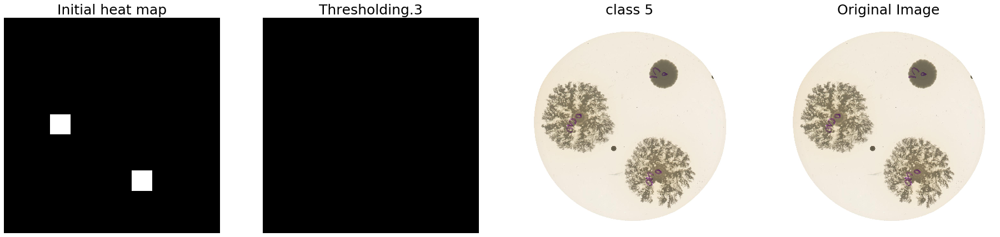

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :133


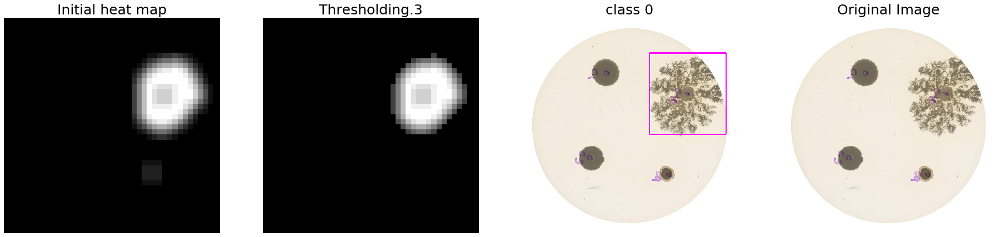

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :16


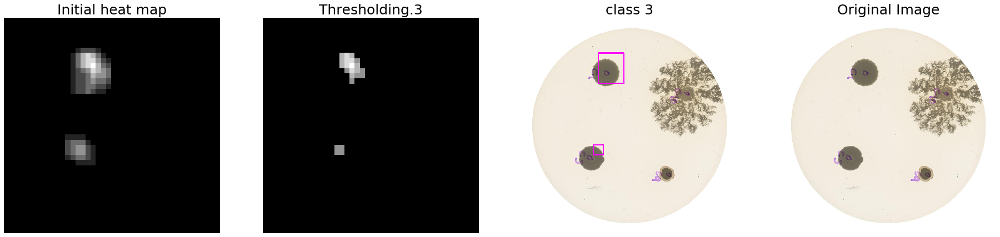

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :4


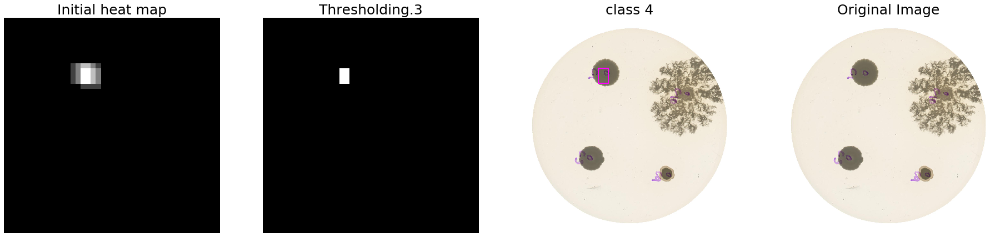

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


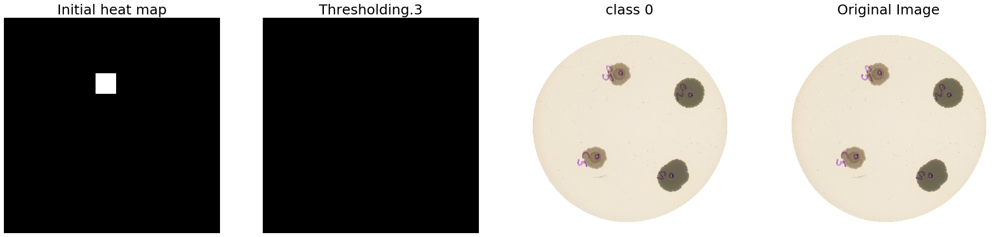

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :34


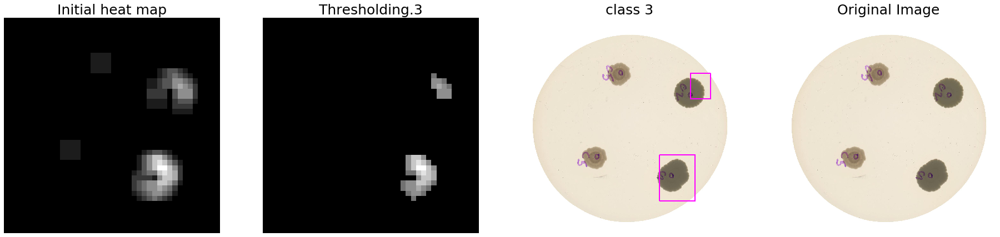

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :13


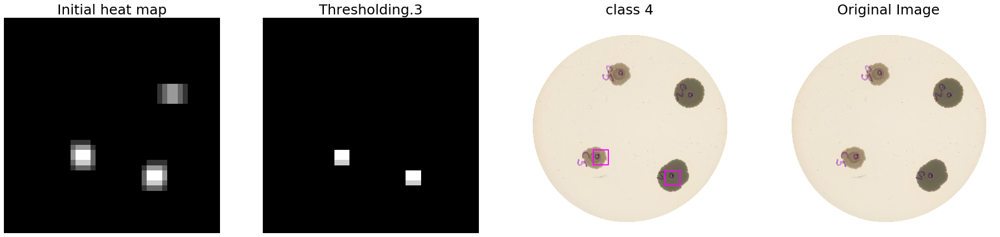

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


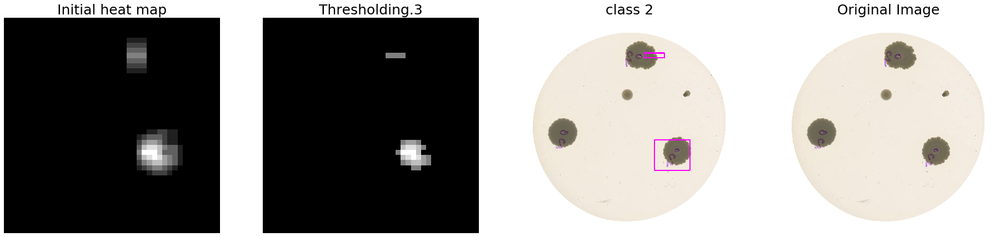

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


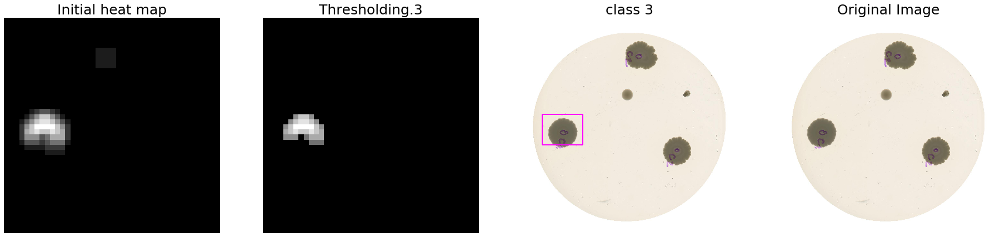

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


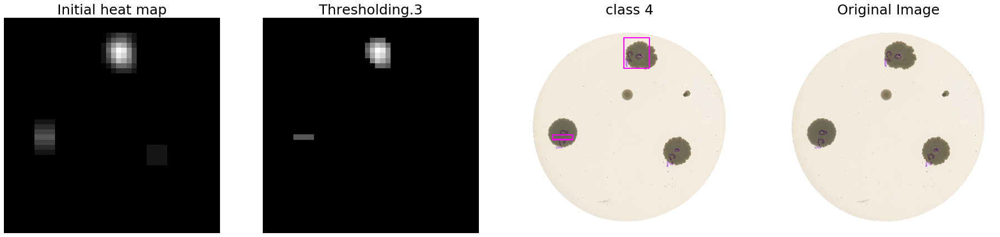

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


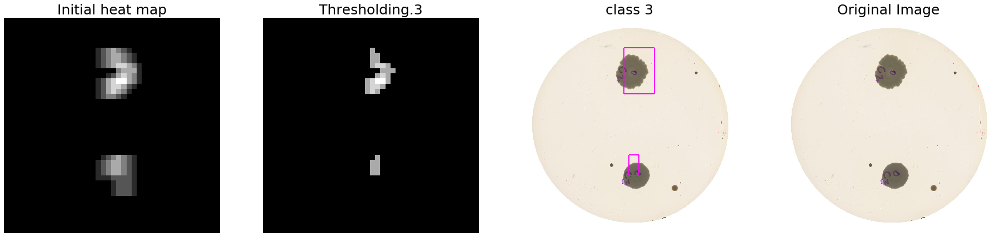

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :15


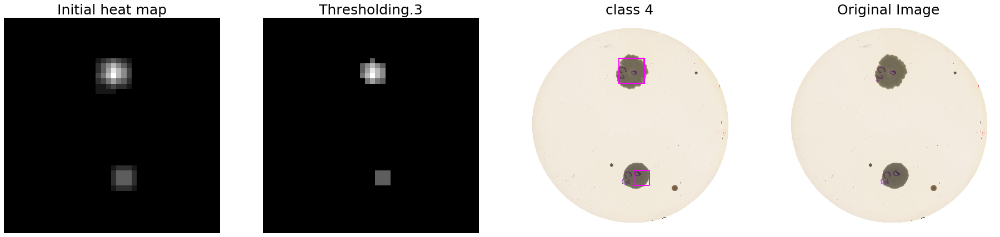

Looking for : 5


Number of boxes :1521
total of obj is :1


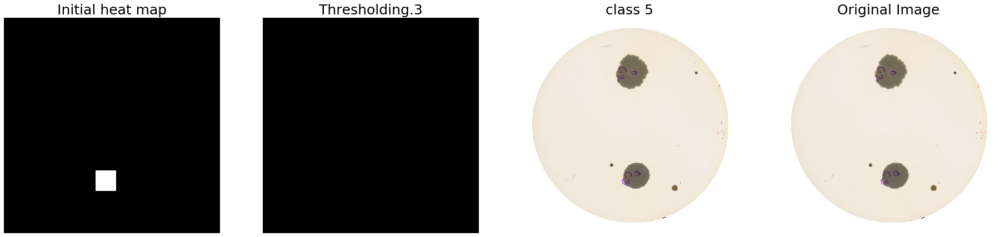

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :6


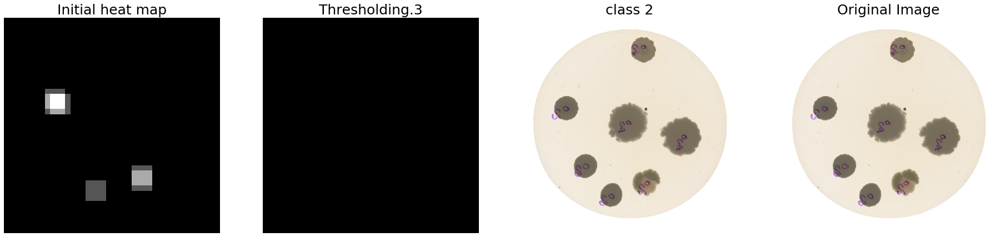

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :102


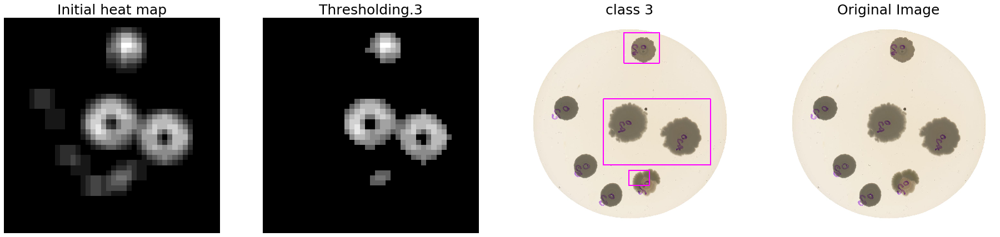

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :33


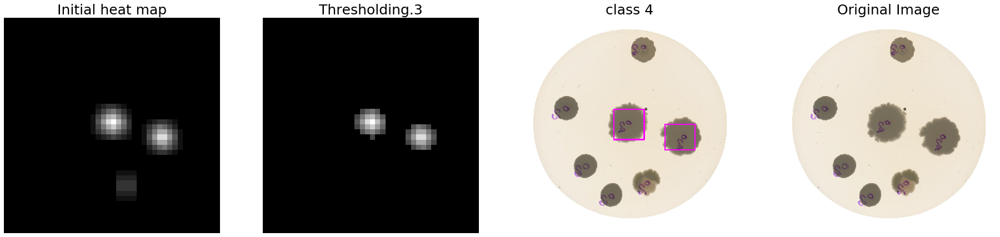

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :7


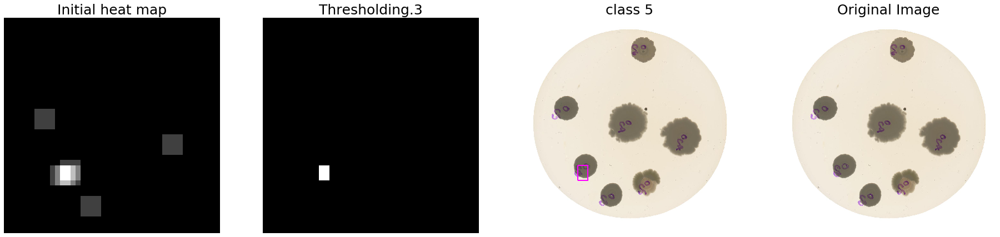

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


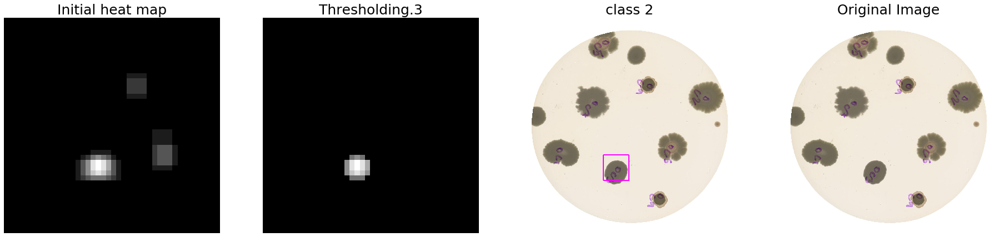

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :70


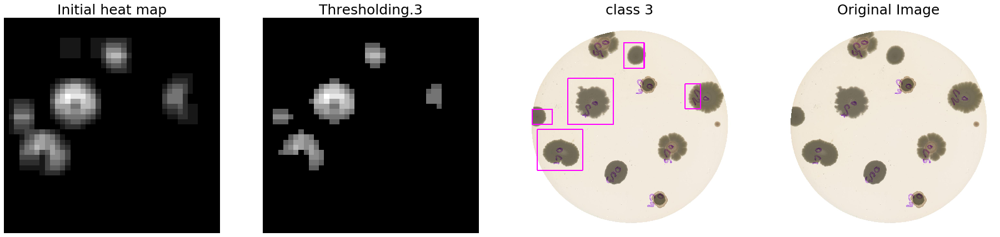

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :30


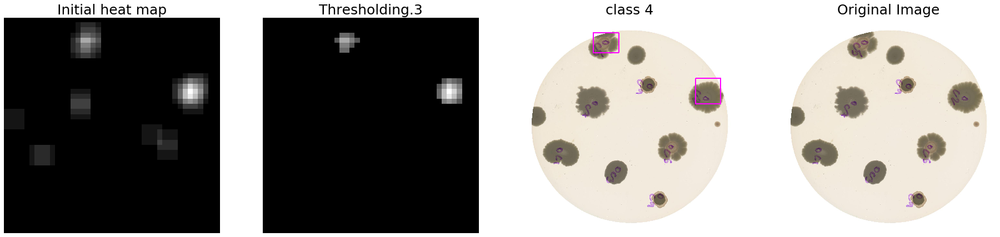

Looking for : 5


Number of boxes :1521
total of obj is :5


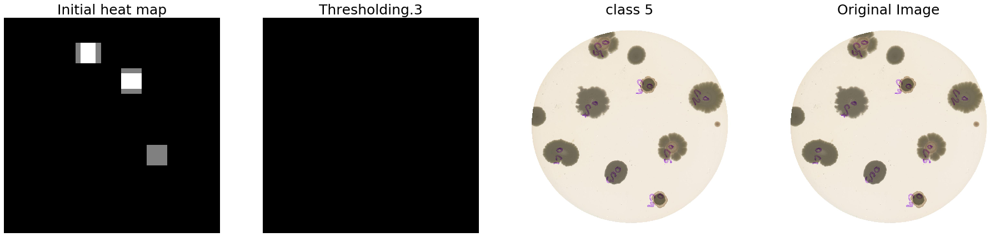

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :77


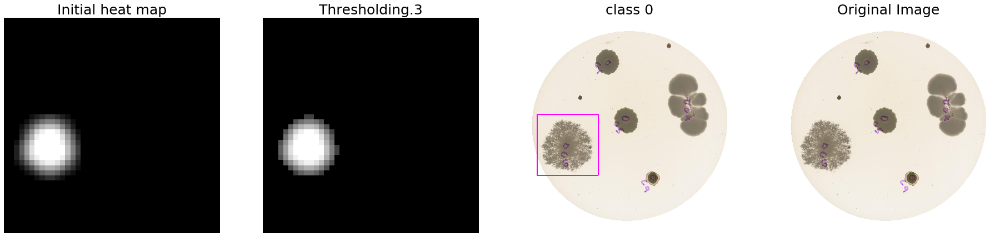

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


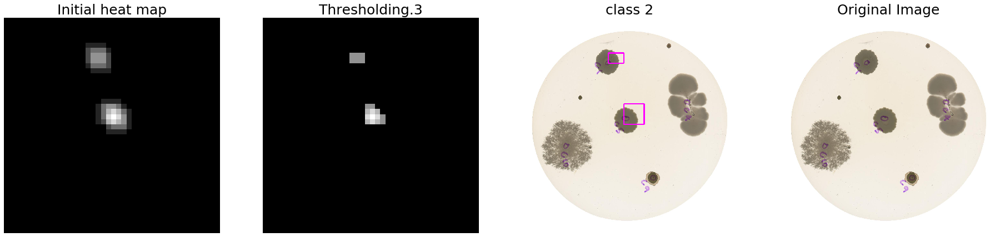

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :84


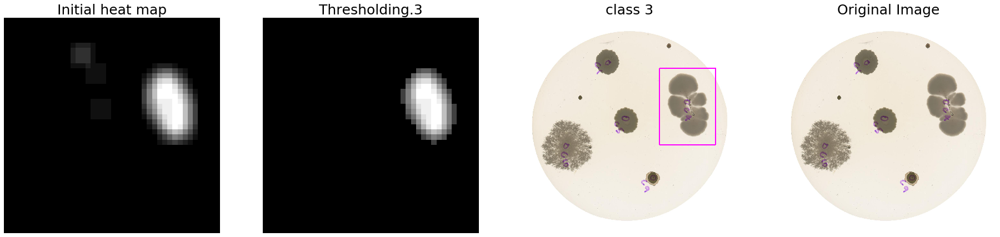

Looking for : 4


Number of boxes :1521
total of obj is :1


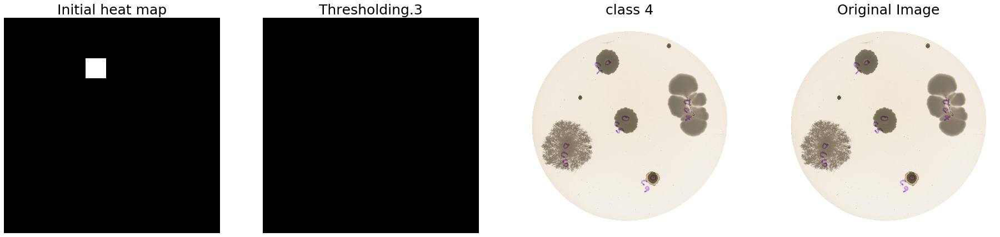

Looking for : 5


Number of boxes :1521
total of obj is :3


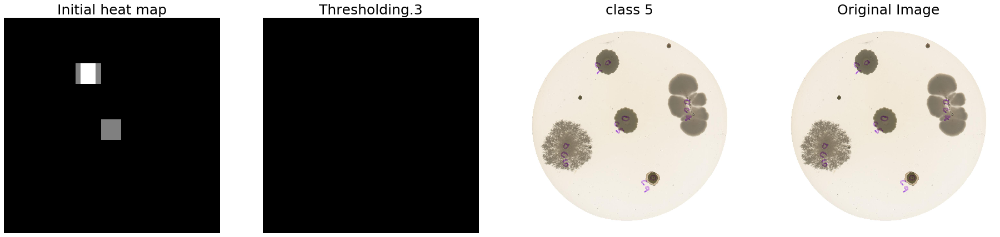

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :19


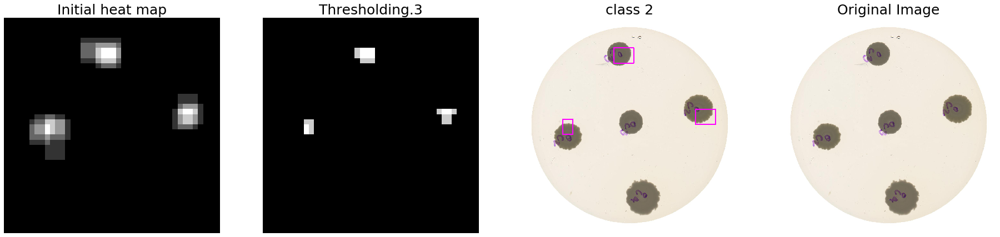

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :42


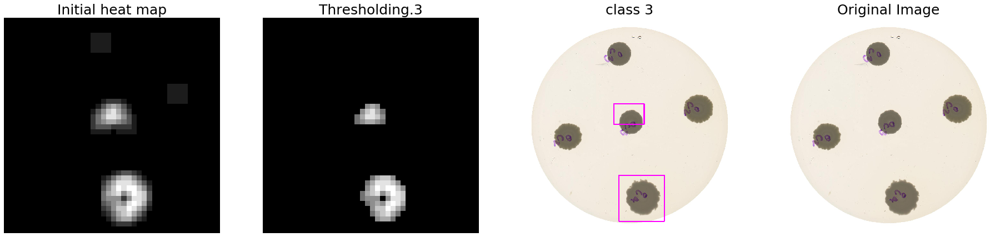

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :14


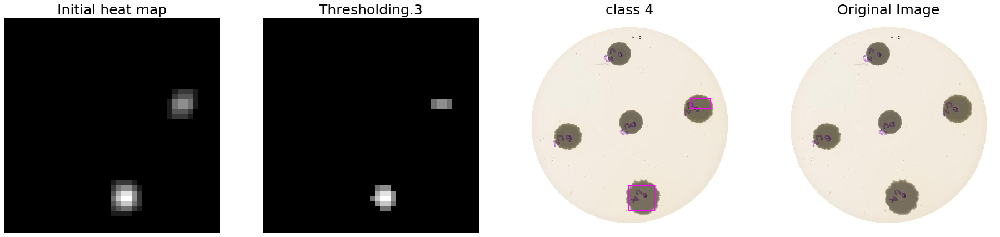

Looking for : 5


Number of boxes :1521
total of obj is :3


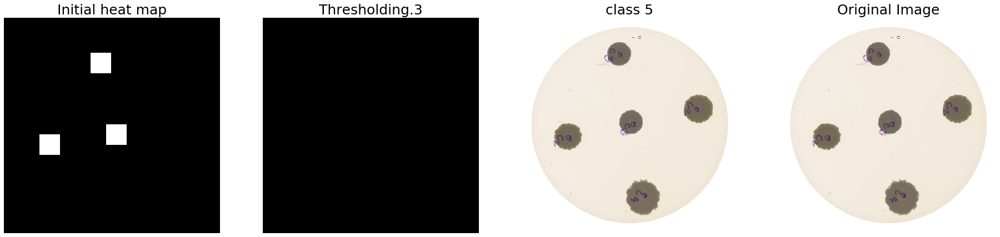

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :10


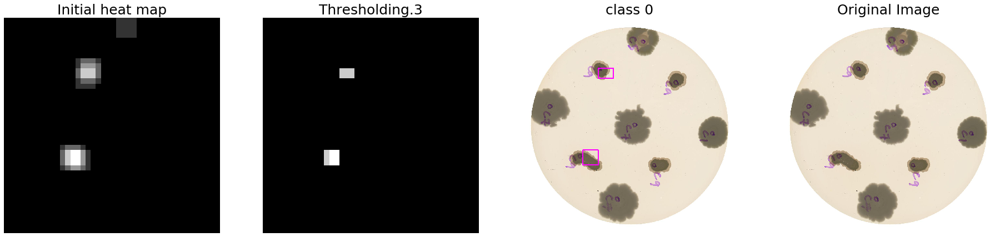

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :20


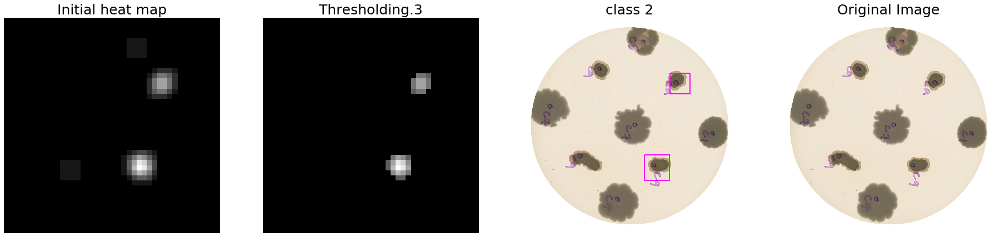

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :89


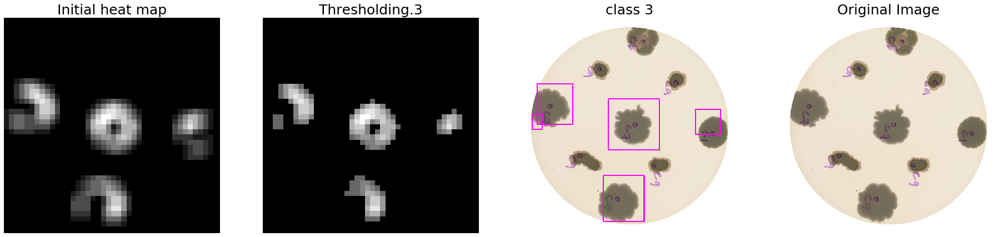

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :87


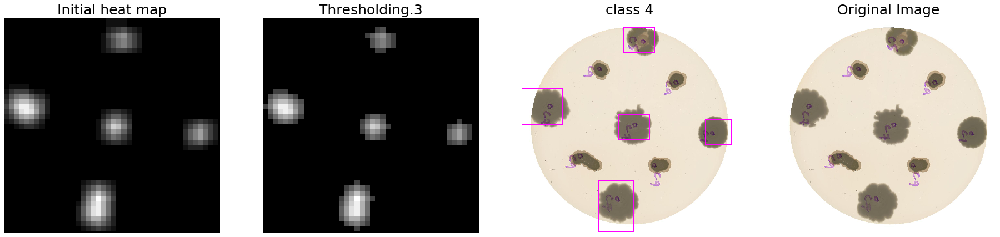

Looking for : 5


Number of boxes :1521
total of obj is :0
Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :102


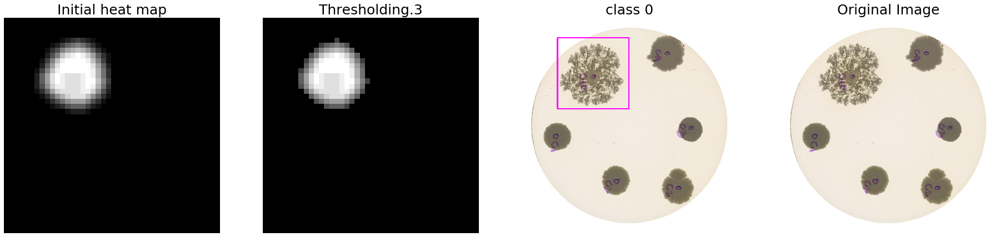

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :3


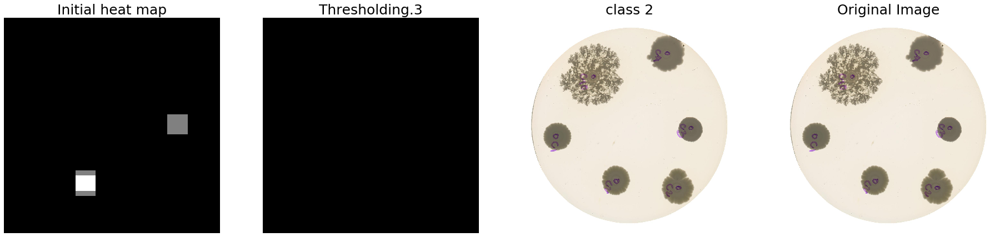

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :65


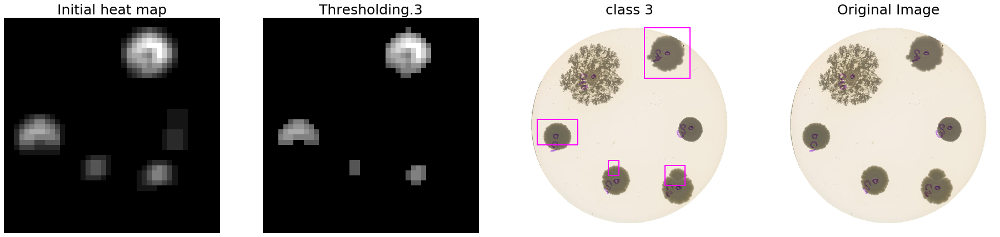

Looking for : 4


Number of boxes :1521
total of obj is :24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


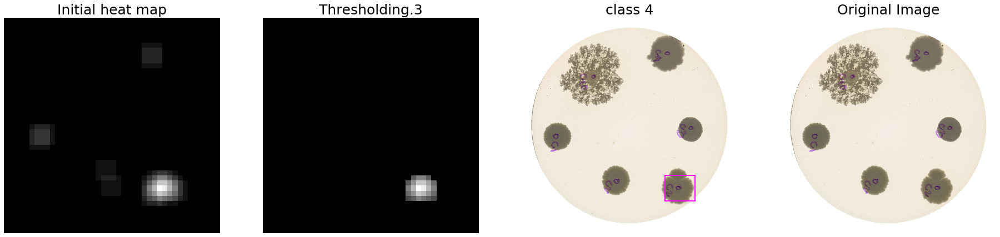

Looking for : 5


Number of boxes :1521
total of obj is :2


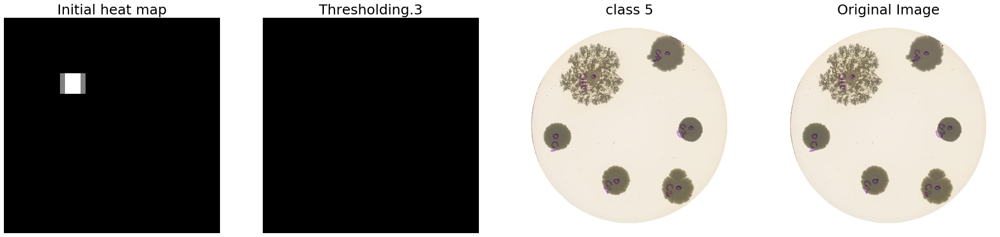

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :1


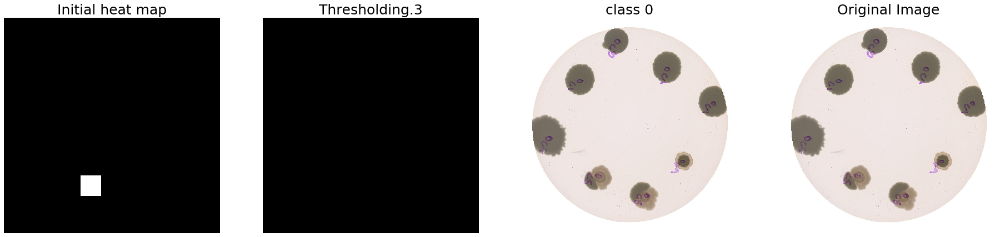

Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :28


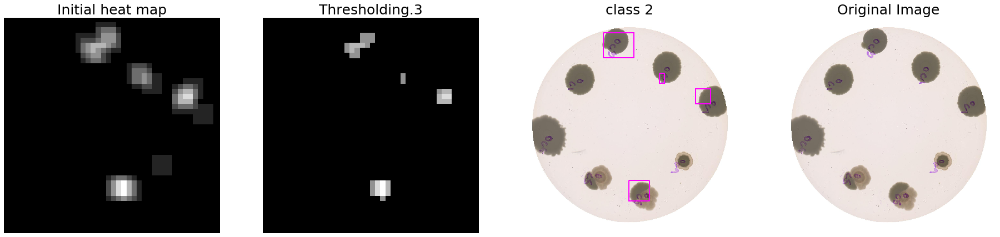

Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :71


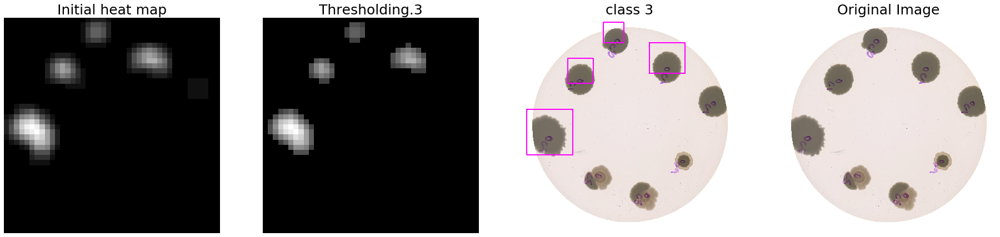

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :17


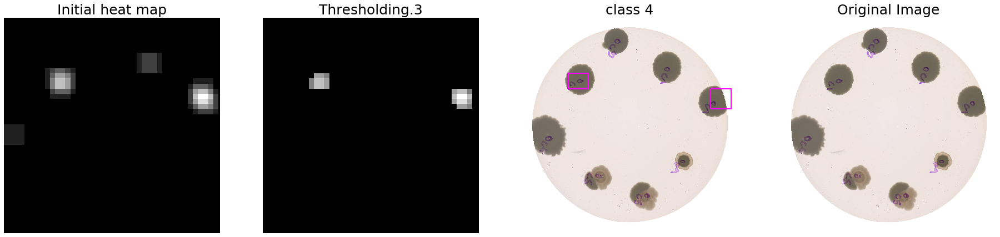

Looking for : 5


Number of boxes :1521
total of obj is :4


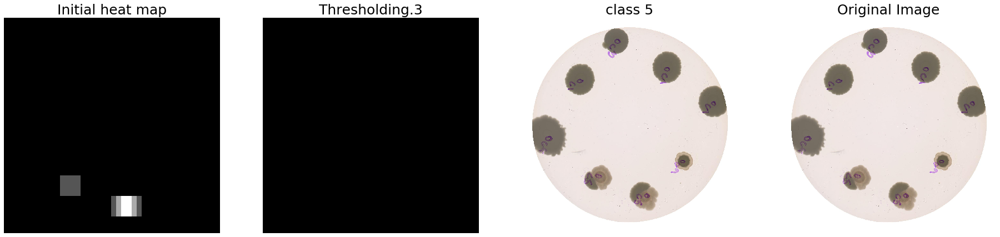

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0


Number of boxes :1521
total of obj is :0
Looking for : 1


Number of boxes :1521
total of obj is :0
Looking for : 2


Number of boxes :1521
total of obj is :0
Looking for : 3




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :56


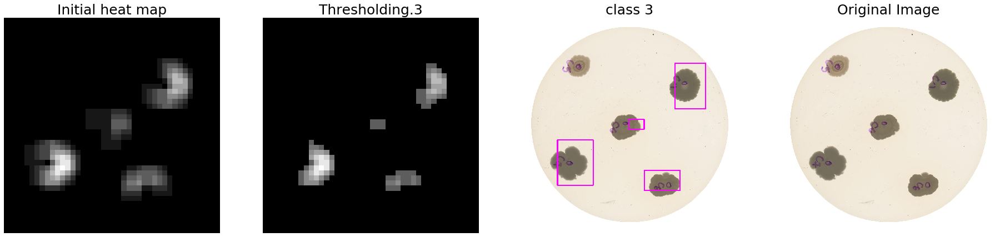

Looking for : 4




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :14


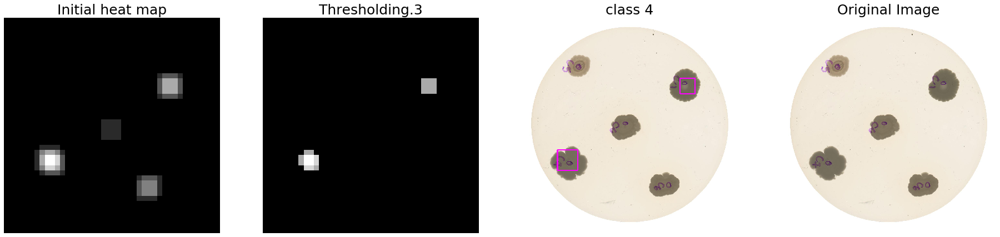

Looking for : 5




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of boxes :1521
total of obj is :11


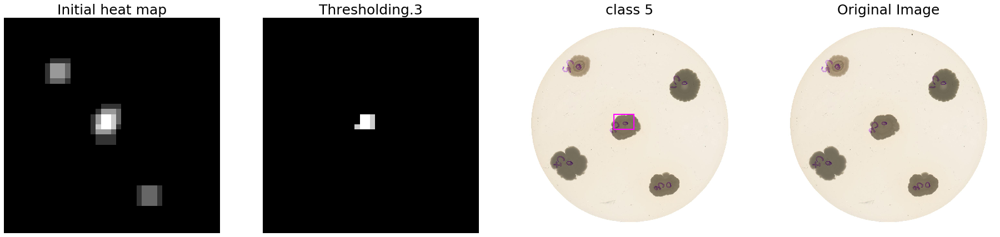

Looking for : 6


Number of boxes :1521
total of obj is :0
Looking for : 7


Number of boxes :1521
total of obj is :0
Looking for : 0




KeyboardInterrupt: ignored

In [0]:
i=0
for data in val_generator:
  i=i+1
  img=data[0]
  confidence_thresh = 0.6
  net=eight_classes_model
  for target in [0,1,2,3,4,5,6,7]:
    print("Looking for : {}".format(target))
    print("\n")
    boxes=get_hot_bboxes(img,net,confidence_thresh,target)
    image=np.copy(img[0])
    for bb in boxes:
      image2=cv2.rectangle(image,bb[0],bb[1], color=(255,0,0), thickness=6) 
    if len(boxes)!=0:
      heat_threshold=3
      save_path='./Outputs/'+str(i)+'_'+str(target)
      heatmap_generation(heat_threshold,np.copy(img[0]),boxes,save_path)

In [0]:
#save the file in the drive 
from google.colab import files
!zip -r /Heatmap_128.zip ./Outputs
!mv /Heatmap_128.zip /content/drive/My\ Drive/Capstone/

# Stop running the cells below

### Adding Heatmap 

In [0]:
def add_heat(heatmap, bbox_list):
    for box in bbox_list:
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    return heatmap

def apply_threshold(heatmap, threshold):
    heatmap[heatmap <= threshold] = 0 
    return heatmap
    
def draw_labeled_heatmap(img, labels):
    # loop over all distinctly detected patches
    for car_number in range(1, labels[1]+1):
        # get pixel indices for current car_number
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        img = cv2.rectangle(img, bbox[0], bbox[1], (255,0,255), 6)
    return img

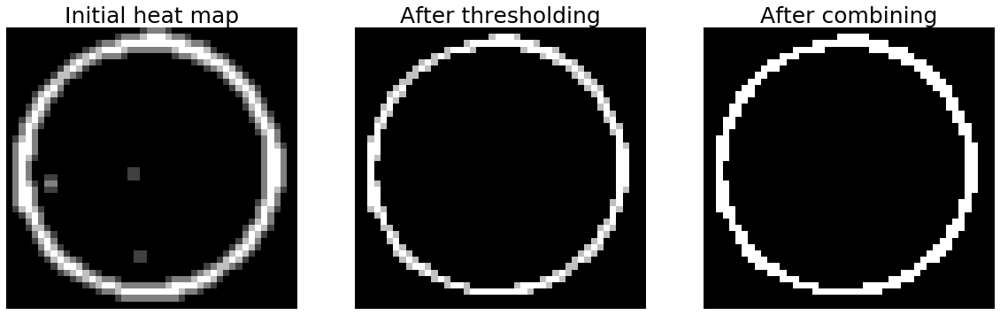

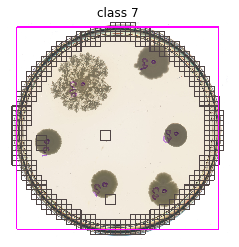

In [0]:
# heat map approach hyperparams
heat_threshold = 2

# intialize heat map
heat = np.zeros_like(image[:,:,0]).astype(np.uint16)
# add all positive box detections to the heat map
heat = add_heat(heat,boxes)
# threshold the heat map
heat_thresh = apply_threshold(np.copy(heat), heat_threshold)
# combine the resulting heat map into continuous patches with identifier, and get number of identifications
labels = label(heat_thresh)
num_car_det = labels[1]
# draw the resulting labels on the original test image
test_img_ann = draw_labeled_heatmap(np.copy(image), labels)

# Visualize the heat map approach
fig, plts = plt.subplots(1, 3, figsize=(20,10))
plts[0].imshow(heat, cmap='gray');      plts[0].axis('off');
plts[0].set_title('Initial heat map', fontsize=25)
plts[1].imshow(heat_thresh, cmap='gray'); plts[1].axis('off');
plts[1].set_title('After thresholding', fontsize=25)
plts[2].imshow(labels[0], cmap='gray'); plts[2].axis('off');
plts[2].set_title('After combining', fontsize=25)
plt.show()

# Visualize the final output
plt.imshow(test_img_ann)
plt.title('class {} '.format(target))
plt.axis('off')
plt.show()